In [2]:
import torch
import pickle
from torch_geometric.data import DataLoader, Data
import numpy as np

/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
device = 6
device = torch.device("cuda:" + str(device)) if torch.cuda.is_available() else torch.device("cpu")

In [5]:
PATH = '/nasdata3/kyj/graphcl/GraphCL_Automated/transferLearning_MoleculeNet_PPI/bio/weights/joao_0.001_20.pth'
model = torch.load(PATH)
#model = model.to(device)


In [16]:
print(model)

TypeError: 'odict_items' object is not subscriptable

In [41]:
dataset_p = torch.load("/nasdata3/kyj/graphcl/GraphCL_Automated/transferLearning_MoleculeNet_PPI/bio/dataset/unsupervised/processed/geometric_data_processed.pt")
dataset_s = torch.load('/nasdata3/kyj/graphcl/GraphCL_Automated/transferLearning_MoleculeNet_PPI/bio/dataset/supervised/processed/geometric_data_processed.pt')
dataset_my = torch.load('/nasdata3/kyj/graphcl/GraphCL_Automated/transferLearning_MoleculeNet_PPI/bio/dataset/my_suvervised/processed/geometric_data_processed.pt')


In [45]:
print(type(dataset_p))

print(dataset_p)
print()
print(dataset_s)
print()
print(dataset_my[1].keys())
for key, values in dataset_p[1].items():
    print(key,':', values.shape, end='\n')

<class 'tuple'>
(Data(center_node_idx=[306925], edge_attr=[223943598, 9], edge_index=[2, 223943598], species_id=[306925], x=[12224362, 1]), {'x': tensor([       0,       51,      112,  ..., 12224300, 12224331, 12224362]), 'edge_index': tensor([        0,       228,       590,  ..., 223942718, 223943158,
        223943598]), 'edge_attr': tensor([        0,       228,       590,  ..., 223942718, 223943158,
        223943598]), 'species_id': tensor([     0,      1,      2,  ..., 306923, 306924, 306925]), 'center_node_idx': tensor([     0,      1,      2,  ..., 306923, 306924, 306925])})

(Data(center_node_idx=[88000], edge_attr=[78387952, 9], edge_index=[2, 78387952], go_target_downstream=[3520000], go_target_pretrain=[440000000], species_id=[88000], x=[4342841, 1]), {'x': tensor([      0,      67,     126,  ..., 4342835, 4342838, 4342841]), 'edge_index': tensor([       0,      316,      632,  ..., 78387944, 78387948, 78387952]), 'edge_attr': tensor([       0,      316,      632,  ..., 78

In [91]:
data=dataset_p
print(data[0].x)

tensor([[1.],
        [1.],
        [1.],
        ...,
        [1.],
        [1.],
        [1.]])


In [74]:
dataset_HCP = torch.load('dataset/my_data/processed/geometric_data_processed.pt')


In [75]:
print(dataset_HCP)

(Data(edge_index=[2, 728448], x=[125744, 232]), {'x': tensor([     0,    671,   1343,  ..., 727103, 727775, 728447]), 'edge_index': tensor([     0,    115,    231,  ..., 125511, 125627, 125743])})


In [19]:
list_file = open('/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/x_pcc/file_list','r').read().split('\n')
list_file.pop()
#list_file.pop(0)
print(len(list_file))
sub_list = []
for i in list_file:
        i=i.strip("pcc_ROISignals_")
        i=i.rstrip(".txt")
        sub_list.append(i)
print(sub_list)

1084
['100206', '100307', '100408', '100610', '101006', '101107', '101309', '101410', '101915', '102008', '102109', '102311', '102513', '102614', '102715', '103010', '103111', '103212', '103414', '103515', '103818', '104012', '104416', '104820', '105014', '105115', '105216', '105620', '105923', '106016', '106319', '106521', '106824', '107018', '107220', '107321', '107422', '107725', '108020', '108121', '108222', '108323', '108525', '108828', '109123', '109325', '109830', '110007', '110411', '110613', '111009', '111211', '111312', '111413', '111514', '111716', '112112', '112314', '112819', '112920', '113215', '113316', '113417', '113619', '113821', '113922', '114116', '114217', '114318', '114419', '114621', '114823', '114924', '115017', '115219', '115320', '115724', '115825', '116120', '116221', '116423', '116524', '116726', '117021', '117122', '117324', '117728', '117930', '118023', '118124', '118225', '118528', '118730', '118831', '118932', '119025', '119126', '119732', '119833', '120

In [192]:
edge_idx_all = torch.LongTensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/edge_index5/{i}_edge_index.txt') as f:
        l = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_idx_all = torch.cat((edge_idx_all,l),0)
        
edge_idx_all = torch.transpose(edge_idx_all,0,1)

torch.int64


In [193]:
x_all = torch.tensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/x_pcc_wth_idx/{i}.pkl','rb') as f:
        l = pickle.load(f)
        l = torch.tensor(l)
        x_all = torch.cat((x_all,l),1)
        
x_all = torch.transpose(x_all,0,1)

In [153]:
print(x_all.shape)

torch.Size([125744, 232])


In [194]:
slice_x = []
slice_edge =[]
i = 0
while i <= 728448:
    slice_edge.append(i)
    i=i+672

i = 0
while i <= 125744:
    slice_x.append(i)
    i = i+116

slice_x = torch.tensor(slice_x)
slice_edge = torch.tensor(slice_edge)
print(slice_x, slice_edge)

slices = {'x' : slice_x, 'edge_index':slice_edge}
print(slices)

#x_all = torch.ones([125744,1])
#print(x_all)

my_data = Data(x=x_all, edge_index=edge_idx_all)

test_data = (my_data,slices)

print(test_data)


torch.save(test_data,'dataset/my_data/processed/geometric_data_processed.pt')


tensor([     0,    116,    232,  ..., 125512, 125628, 125744]) tensor([     0,    672,   1344,  ..., 727104, 727776, 728448])
{'x': tensor([     0,    116,    232,  ..., 125512, 125628, 125744]), 'edge_index': tensor([     0,    672,   1344,  ..., 727104, 727776, 728448])}
(Data(edge_index=[2, 728448], x=[125744, 232]), {'x': tensor([     0,    116,    232,  ..., 125512, 125628, 125744]), 'edge_index': tensor([     0,    672,   1344,  ..., 727104, 727776, 728448])})


In [31]:
#sparsity 별 unsupervised Dataset 만들기

list_file = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_cc200_1d/list','r').read().split('\n')
list_file.pop()
list_file.pop(0)
print(len(list_file))
#sub_list = []
#for i in list_file:
#        i=i.strip("pcc_ROISignals_")
#        i=i.rstrip(".txt")
#        sub_list.append(i)
# print(sub_list)

edge_idx_all = torch.LongTensor([])
for i in list_file:
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_cc200_1d/make_edge/edge_index20/cc_{i}_edge_index.txt') as f:
        l = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_idx_all = torch.cat((edge_idx_all,l),0)
        
edge_idx_all = torch.transpose(edge_idx_all,0,1)
print(edge_idx_all.shape)

x_all = torch.tensor([])
for i in list_file:
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_cc200_1d/make_edge/cc_{i}.txt','r') as f:
        #l = pickle.load(f)
        f = f.readlines()
        #print(f)
        for j in range(len(f)):
            f[j] = f[j].rstrip('\n')
        l = [[float(num) for num in line.split( )] for line in f]
        #print(l)
        l = torch.LongTensor(l)
        x_all = torch.cat((x_all,l),1)
print(x_all.shape)        
x_all = torch.transpose(x_all,0,1)

slice_x = []
slice_edge =[]
i = 0
while i <=7784000:
    slice_edge.append(i)
    i=i+8000


i = 0
while i <= 194600:
    slice_x.append(i)
    i = i+200

slice_x = torch.tensor(slice_x)
slice_edge = torch.tensor(slice_edge)
print(slice_x, slice_edge)

slices = {'x' : slice_x, 'edge_index':slice_edge}
print(slices)

#x_all = torch.ones([125744,1])
#print(x_all)

my_data = Data(x=x_all, edge_index=edge_idx_all)

test_data = (my_data,slices)

print(test_data)


torch.save(test_data,'dataset/spars20_unsupervised/abide/only_cc_cc200/processed/geometric_data_processed.pt')

973
torch.Size([2, 7784000])


/tmp/ipykernel_11360/3819526204.py:33: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  l = torch.LongTensor(l)


torch.Size([200, 194600])
tensor([     0,    200,    400,    600,    800,   1000,   1200,   1400,   1600,
          1800,   2000,   2200,   2400,   2600,   2800,   3000,   3200,   3400,
          3600,   3800,   4000,   4200,   4400,   4600,   4800,   5000,   5200,
          5400,   5600,   5800,   6000,   6200,   6400,   6600,   6800,   7000,
          7200,   7400,   7600,   7800,   8000,   8200,   8400,   8600,   8800,
          9000,   9200,   9400,   9600,   9800,  10000,  10200,  10400,  10600,
         10800,  11000,  11200,  11400,  11600,  11800,  12000,  12200,  12400,
         12600,  12800,  13000,  13200,  13400,  13600,  13800,  14000,  14200,
         14400,  14600,  14800,  15000,  15200,  15400,  15600,  15800,  16000,
         16200,  16400,  16600,  16800,  17000,  17200,  17400,  17600,  17800,
         18000,  18200,  18400,  18600,  18800,  19000,  19200,  19400,  19600,
         19800,  20000,  20200,  20400,  20600,  20800,  21000,  21200,  21400,
         21600

In [3]:
#HCP 데이터 sparsity 별 unsupervised Dataset 만들기

list_file = open('/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/x_pcc/file_list','r').read().split('\n')
list_file.pop()
list_file.pop(0)
print(len(list_file))
sub_list = []
for i in list_file:
        i=i.strip("pcc_ROISignals_")
        i=i.rstrip(".txt")
        sub_list.append(i)
# print(sub_list)

edge_idx_all = torch.LongTensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/edge_index20/{i}_edge_index.txt') as f:
        l = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_idx_all = torch.cat((edge_idx_all,l),0)
        
edge_idx_all = torch.transpose(edge_idx_all,0,1)

x_all = torch.tensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/x_cc/cc_{i}.txt','r') as f:
        #l = pickle.load(f)
        #print(l)
        # f = l.readlines()
        # print(f)
        # for j in range(len(f)):
        #    f[j] = f[j].rstrip('\n')
        # l = [[float(num) for num in line.split(',')] for line in f]
        # print(l)
        l =[[float(num) for num in line.split(',')] for line in f]
        l = torch.LongTensor(l)
        print(l.shape)
        x_all = torch.cat((x_all,l),1)
print(x_all.shape)
x_all = torch.transpose(x_all,0,1)

slice_x = []
slice_edge =[]
i = 0
while i <=2915436:
    slice_edge.append(i)
    i=i+2692


i = 0
while i <= 125628:
    slice_x.append(i)
    i = i+116

slice_x = torch.tensor(slice_x)
slice_edge = torch.tensor(slice_edge)
print(slice_x, slice_edge)

slices = {'x' : slice_x, 'edge_index':slice_edge}
print(slices)

#x_all = torch.ones([125744,1])
#print(x_all)

my_data = Data(x=x_all, edge_index=edge_idx_all)

test_data = (my_data,slices)

print(test_data)


torch.save(test_data,'dataset/spars20_unsupervised/processed/only_cc/processed/geometric_data_processed.pt')

1083


/tmp/ipykernel_2227/3370939508.py:34: DeprecationWarning: an integer is required (got type float).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  l = torch.LongTensor(l)


torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size(

In [66]:
import scipy.io as sio

roi_center_of_mass = sio.loadmat('/nasdata4/kyj0305/HCP/fMRI_prep/Results/ROISignals_funimgRWSCFB/ROI_CenterOfMass_922854')
roi_center_of_mass = roi_center_of_mass['ROICenter']
roi_center_of_mass = roi_center_of_mass[:,0:3]
roi_center_of_mass = torch.LongTensor(roi_center_of_mass)
print(roi_center_of_mass)

list_file = open('/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc/file_list','r').read().split('\n')
list_file.pop()
list_file.pop(0)
# print(list_file)
sub_list = []
# for i in list_file:
        # i=i.strip("pcc_ROISignals_")
        # i=i.rstrip(".txt")
        # sub_list.append(i)
# print(sub_list)


for i in list_file:
        #with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc/{i}','r') as f:
        #        f = f.readlines()
        #for j in range(len(f)):
        #    f[j] = f[j].rstrip('\n')
        #l = [[torch.FloatTensor(num) for num in line.split(',')] for line in f]
        l = np.loadtxt(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc/{i}', delimiter=' ')
        l = torch.FloatTensor(l)
        l = torch.cat((l, roi_center_of_mass),1)
        l = torch.transpose(l,0,1)
        i=i.strip("pcc_ROISignals_")
        i=i.rstrip(".txt")
        np.savetxt(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc_roi_coordinate/{i}.txt',l, delimiter=",", fmt='%f')
        
print(l[0])
        
        



tensor([[-39,  -6,  51],
        [ 39,  -9,  51],
        [-18,  36,  42],
        [ 21,  30,  45],
        [-18,  48, -12],
        [ 18,  48, -15],
        [-33,  33,  36],
        [ 36,  33,  33],
        [-33,  51,  -9],
        [ 33,  51, -12],
        [-48,  12,  21],
        [ 48,  15,  21],
        [-48,  30,  15],
        [ 48,  30,  15],
        [-36,  30, -12],
        [ 42,  33, -12],
        [-48,  -9,  15],
        [ 51,  -6,  15],
        [ -6,   6,  60],
        [  9,   0,  63],
        [ -9,  15, -12],
        [  9,  15, -12],
        [ -6,  48,  30],
        [  9,  51,  33],
        [ -6,  54,  -6],
        [  6,  51,  -6],
        [ -6,  36, -18],
        [  9,  36, -18],
        [-36,   6,   3],
        [ 39,   6,   3],
        [ -6,  36,  12],
        [  9,  36,  18],
        [ -6, -15,  42],
        [  9,  -9,  39],
        [ -6, -42,  24],
        [  6, -42,  21],
        [-27, -21,  -9],
        [ 27, -21,  -9],
        [-21, -15, -21],
        [ 24, -15, -21],


In [60]:
#sparsity 별 unsupervised Dataset 만들기
# ++ roi index 아니고 roi 좌표로 node feature 생성

list_file = open('/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/x_pcc/file_list','r').read().split('\n')
list_file.pop()
list_file.pop(0)
print(len(list_file))
sub_list = []
for i in list_file:
        i=i.strip("pcc_ROISignals_")
        i=i.rstrip(".txt")
        sub_list.append(i)
# print(sub_list)

edge_idx_all = torch.LongTensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/edge_index15/{i}_edge_index.txt') as f:
        l = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_idx_all = torch.cat((edge_idx_all,l),0)
        
edge_idx_all = torch.transpose(edge_idx_all,0,1)

x_all = torch.tensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/HCP_data/x_pcc_roi_coordinate/{i}.txt','r') as f:
        #l = pickle.load(f)
        f = f.readlines()
        #print(f)
        for j in range(len(f)):
            f[j] = f[j].rstrip('\n')
        l = [[float(num) for num in line.split(',')] for line in f]
        #print(l)
        l = torch.FloatTensor(l)
        x_all = torch.cat((x_all,l),1)
        
x_all = torch.transpose(x_all,0,1)

slice_x = []
slice_edge =[]
i = 0
while i <=2185494:
    slice_edge.append(i)
    i=i+2018


i = 0
while i <= 125628:
    slice_x.append(i)
    i = i+116

slice_x = torch.tensor(slice_x)
slice_edge = torch.tensor(slice_edge)
print(slice_x, slice_edge)

slices = {'x' : slice_x, 'edge_index':slice_edge}
print(slices)

#x_all = torch.ones([125744,1])
#print(x_all)

my_data = Data(x=x_all, edge_index=edge_idx_all)

test_data = (my_data,slices)

print(test_data)


torch.save(test_data,'dataset/spars15_unsupervised/processed_ROICoordinate/geometric_data_processed.pt')

1083
tensor([     0,    116,    232,  ..., 125396, 125512, 125628]) tensor([      0,    2018,    4036,  ..., 2181458, 2183476, 2185494])
{'x': tensor([     0,    116,    232,  ..., 125396, 125512, 125628]), 'edge_index': tensor([      0,    2018,    4036,  ..., 2181458, 2183476, 2185494])}
(Data(edge_index=[2, 2185494], x=[125628, 119]), {'x': tensor([     0,    116,    232,  ..., 125396, 125512, 125628]), 'edge_index': tensor([      0,    2018,    4036,  ..., 2181458, 2183476, 2185494])})


In [101]:
from loader import BioDataset_graphcl, DataLoader
aug_mode='sample'
aug_strength=0.2

root_unsupervised = 'dataset/unsupervised'
dataset = BioDataset_graphcl(root_unsupervised, data_type='unsupervised')
dataset.set_augMode(aug_mode)
dataset.set_augStrength(aug_strength)
print(dataset)


what is processed_path:  ['dataset/unsupervised/processed/geometric_data_processed.pt']
BioDataset_graphcl(306925)


In [197]:
import numpy as np

m = torch.tensor([[2,3],[4,5]])
print(m[np.arange(2),np.arange(2)])

tensor([2, 5])


In [29]:

from loader import BioDataset

root_supervised = 'dataset/supervised'
dataset = BioDataset(root_supervised, data_type='supervised')
print(dataset[0].go_target_downstream.shape)


what is processed_path:  ['dataset/supervised/processed/geometric_data_processed.pt']
torch.Size([40])


In [71]:
for i in range(50):
    print(dataset[i])


Data(center_node_idx=[1], edge_attr=[316, 9], edge_index=[2, 316], go_target_downstream=[40], go_target_pretrain=[5000], species_id=[1], x=[67, 1])
Data(center_node_idx=[1], edge_attr=[316, 9], edge_index=[2, 316], go_target_downstream=[40], go_target_pretrain=[5000], species_id=[1], x=[59, 1])
Data(center_node_idx=[1], edge_attr=[132, 9], edge_index=[2, 132], go_target_downstream=[40], go_target_pretrain=[5000], species_id=[1], x=[38, 1])
Data(center_node_idx=[1], edge_attr=[140, 9], edge_index=[2, 140], go_target_downstream=[40], go_target_pretrain=[5000], species_id=[1], x=[43, 1])
Data(center_node_idx=[1], edge_attr=[320, 9], edge_index=[2, 320], go_target_downstream=[40], go_target_pretrain=[5000], species_id=[1], x=[70, 1])
Data(center_node_idx=[1], edge_attr=[144, 9], edge_index=[2, 144], go_target_downstream=[40], go_target_pretrain=[5000], species_id=[1], x=[31, 1])
Data(center_node_idx=[1], edge_attr=[310, 9], edge_index=[2, 310], go_target_downstream=[40], go_target_pretrain

In [188]:
from loader import BioDataset_graphcl, DataLoader
from tqdm import tqdm
from torch_geometric.utils import add_self_loops
aug_mode='sample'
aug_strength=0.2

root_unsupervised = 'dataset/my_data'
dataset_HCP = BioDataset_graphcl(root_unsupervised, data_type='unsupervised')
dataset_HCP.set_augMode(aug_mode)
dataset_HCP.set_augStrength(aug_strength)
print(len(dataset_HCP))

loader = DataLoader(dataset_HCP, batch_size=2, num_workers=1, shuffle=True)

for step, batch in enumerate(tqdm(loader, desc="Iteration")):
    # for step, batch in enumerate(loader, desc="Iteration"):
        _, batch1, batch2 = batch
        batch1 = batch1
        batch2 = batch2
        
        print('batch1 edge_index:', batch1.edge_index.shape )
        print('batch1 x: ', batch1.x.shape)
        print('batch.max: ', batch1.batch.shape)
        print()
        #print('batch2 edge_index:', batch2.edge_index.shape )
        #print('batch2 x: ', batch2.x.shape)

edge_index, _ = add_self_loops(batch1.edge_index, num_nodes = 116)
print(edge_index.shape)


what is processed_path:  ['dataset/my_data/processed/geometric_data_processed.pt']
1084


Iteration:   1%|▏         | 8/542 [00:00<00:42, 12.70it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1168])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1100])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1120])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1116])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:   4%|▎         | 20/542 [00:01<00:17, 29.23it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1324])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1076])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1098])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1082])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 958])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1340])
batch1

Iteration:   7%|▋         | 36/542 [00:01<00:11, 45.04it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 872])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1334])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1310])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1098])
batch1

Iteration:   9%|▉         | 50/542 [00:01<00:09, 52.74it/s]

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1054])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 886])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1094])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1142])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1

Iteration:  11%|█         | 57/542 [00:01<00:08, 54.47it/s]

batch1 edge_index: torch.Size([2, 1022])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1086])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1144])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1082])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1154])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1082])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 916])
batch1

Iteration:  13%|█▎        | 69/542 [00:01<00:09, 51.87it/s]

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1134])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1038])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  15%|█▍        | 80/542 [00:02<00:09, 46.56it/s]

batch1 edge_index: torch.Size([2, 1110])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1110])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1090])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1090])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1060])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1118])
batch

Iteration:  17%|█▋        | 94/542 [00:02<00:08, 53.72it/s]

batch1 edge_index: torch.Size([2, 1116])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1026])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1128])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1136])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 796])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1070])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1

Iteration:  20%|█▉        | 107/542 [00:02<00:07, 59.29it/s]

batch1 edge_index: torch.Size([2, 836])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1156])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 884])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1064])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1082])
batch1 

Iteration:  21%|██        | 114/542 [00:02<00:07, 55.84it/s]

batch1 edge_index: torch.Size([2, 820])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1110])
batch1

Iteration:  23%|██▎       | 126/542 [00:02<00:08, 51.52it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1092])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1336])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1164])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  26%|██▌       | 139/542 [00:03<00:07, 57.12it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1184])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1076])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1202])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1118])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1112])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1310])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1342])
batch

Iteration:  28%|██▊       | 151/542 [00:03<00:07, 55.52it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1168])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1052])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1202])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1106])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1108])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  30%|███       | 165/542 [00:03<00:06, 55.80it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1088])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1070])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1336])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1100])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1052])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1116])
batch

Iteration:  32%|███▏      | 171/542 [00:03<00:06, 53.02it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1316])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1038])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1302])
batch

Iteration:  34%|███▍      | 183/542 [00:03<00:06, 54.32it/s]

batch1 edge_index: torch.Size([2, 1336])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1330])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1094])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1072])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1082])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1074])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1334])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  36%|███▌      | 195/542 [00:04<00:06, 53.12it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1080])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1104])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1062])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1102])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  38%|███▊      | 207/542 [00:04<00:06, 48.21it/s]

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1122])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])



Iteration:  39%|███▉      | 212/542 [00:04<00:07, 46.65it/s]

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1332])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1106])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1320])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1126])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])



Iteration:  41%|████      | 223/542 [00:04<00:06, 47.29it/s]

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1100])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 852])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1

Iteration:  43%|████▎     | 235/542 [00:05<00:05, 51.86it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1326])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 836])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1062])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1100])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1

Iteration:  46%|████▌     | 247/542 [00:05<00:05, 54.29it/s]

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1060])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1110])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch

Iteration:  48%|████▊     | 260/542 [00:05<00:05, 52.42it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1086])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1118])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 888])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1076])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1012])
batch1

Iteration:  50%|█████     | 273/542 [00:05<00:05, 51.22it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1092])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1312])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1280])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1298])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1098])
batch

Iteration:  53%|█████▎    | 285/542 [00:05<00:04, 53.15it/s]

batch1 edge_index: torch.Size([2, 1318])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1070])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1108])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1332])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1334])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  55%|█████▍    | 298/542 [00:06<00:04, 55.63it/s]

batch1 edge_index: torch.Size([2, 1054])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1136])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1130])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 864])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1070])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1038])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1

Iteration:  56%|█████▌    | 304/542 [00:06<00:04, 55.25it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1140])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1060])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1102])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1112])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1080])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1068])
batch

Iteration:  58%|█████▊    | 317/542 [00:06<00:04, 46.75it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1092])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1314])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1076])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])



Iteration:  59%|█████▉    | 322/542 [00:06<00:04, 46.45it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1074])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1020])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1040])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  62%|██████▏   | 335/542 [00:06<00:03, 52.56it/s]

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1130])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1084])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1072])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1334])
batch

Iteration:  64%|██████▍   | 348/542 [00:07<00:03, 50.02it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1332])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1114])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1310])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])



Iteration:  66%|██████▋   | 360/542 [00:07<00:03, 49.43it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 864])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1108])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1168])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1038])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1090])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1068])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 824])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1070])
batch1 

Iteration:  68%|██████▊   | 367/542 [00:07<00:03, 53.07it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1096])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1124])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1124])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1126])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1304])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1062])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  70%|███████   | 380/542 [00:07<00:03, 53.81it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1120])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1044])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1080])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  72%|███████▏  | 392/542 [00:08<00:02, 50.00it/s]

batch1 edge_index: torch.Size([2, 1078])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1088])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1100])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1064])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1336])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1100])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1044])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1190])
batch

Iteration:  75%|███████▍  | 405/542 [00:08<00:02, 54.76it/s]

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1322])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 954])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1140])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1096])
batch1

Iteration:  77%|███████▋  | 417/542 [00:08<00:02, 53.69it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1064])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1128])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1062])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1056])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  79%|███████▉  | 429/542 [00:08<00:02, 52.64it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1326])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 980])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1044])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1116])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1108])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1100])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1

Iteration:  81%|████████  | 437/542 [00:08<00:01, 57.87it/s]

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1128])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1066])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1130])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1034])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 894])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1096])
batch1

Iteration:  82%|████████▏ | 443/542 [00:09<00:01, 50.28it/s]

batch1 edge_index: torch.Size([2, 1104])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 982])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])



Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f3ea69a3f70>
Traceback (most recent call last):
  File "/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f3ea69a3f70>
Traceback (most recent call last):
  File "/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/nasdata3/kyj/anaconda3/envs/graphcl/

batch1 edge_index: torch.Size([2, 1286])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1098])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1136])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1332])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])



Iteration:  84%|████████▍ | 454/542 [00:09<00:03, 28.74it/s]

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1120])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1282])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1062])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1148])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 882])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])



Iteration:  86%|████████▌ | 466/542 [00:09<00:02, 37.87it/s]

batch1 edge_index: torch.Size([2, 1202])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1168])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1072])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1302])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 884])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1092])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1146])
batch1

Iteration:  88%|████████▊ | 478/542 [00:10<00:01, 44.62it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1328])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1218])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  90%|█████████ | 490/542 [00:10<00:01, 45.12it/s]

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1330])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1336])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1266])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1072])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1080])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  91%|█████████▏| 495/542 [00:10<00:01, 42.35it/s]

batch1 edge_index: torch.Size([2, 1294])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1042])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1126])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1082])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1324])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 904])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1094])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1058])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1340])
batch1

Iteration:  94%|█████████▎| 507/542 [00:10<00:00, 47.55it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1232])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1244])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1068])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1146])
batch

Iteration:  96%|█████████▌| 519/542 [00:10<00:00, 46.13it/s]

batch1 edge_index: torch.Size([2, 1086])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1334])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1078])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1338])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration:  98%|█████████▊| 531/542 [00:11<00:00, 50.26it/s]

batch1 edge_index: torch.Size([2, 1080])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1112])
batch1 x:  torch.Size([186, 232])
batch.max:  torch.Size([186])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1342])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1060])
batch

Iteration:  99%|█████████▉| 537/542 [00:11<00:00, 51.24it/s]

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1152])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1092])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1344])
batch1 x:  torch.Size([232, 232])
batch.max:  torch.Size([232])

batch1 edge_index: torch.Size([2, 1334])
batch1 x:  torch.Size([209, 232])
batch.max:  torch.Size([209])

batch1 edge_index: torch.Size([2, 1344])
batch

Iteration: 100%|██████████| 542/542 [00:12<00:00, 45.10it/s]

torch.Size([2, 1210])


In [159]:
print(dataset[1])
print(dataset_HCP[1][0].x.size(0))

(Data(center_node_idx=[1], edge_attr=[362, 9], edge_index=[2, 362], species_id=[1], x=[61, 1]), Data(center_node_idx=[1], edge_attr=[362, 9], edge_index=[2, 224], species_id=[1], x=[49, 1]), Data(center_node_idx=[1], edge_attr=[362, 9], edge_index=[2, 362], species_id=[1], x=[61, 1]))
116


In [189]:
input_node_embeddings = torch.nn.Embedding(2, 300)
print(torch.nn.init.xavier_uniform_(input_node_embeddings.weight.data).shape)
x=dataset_HCP[1][0].x
print('view : ',x.to(torch.int64))
print('view.shape : ', x.to(torch.int64).shape)
x = input_node_embeddings(x.to(torch.int64))
print(x)
print(x.shape)

torch.Size([2, 300])
view :  tensor([[1, 0, 0,  ..., 0, 0, 0],
        [0, 1, 0,  ..., 0, 0, 0],
        [0, 0, 1,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 1, 0],
        [0, 0, 0,  ..., 0, 0, 1]])
view.shape :  torch.Size([116, 232])
tensor([[[ 0.0209,  0.1370,  0.1175,  ..., -0.1395,  0.1406,  0.1087],
         [ 0.0756,  0.0631,  0.0485,  ..., -0.0278,  0.0426, -0.0695],
         [ 0.0756,  0.0631,  0.0485,  ..., -0.0278,  0.0426, -0.0695],
         ...,
         [ 0.0756,  0.0631,  0.0485,  ..., -0.0278,  0.0426, -0.0695],
         [ 0.0756,  0.0631,  0.0485,  ..., -0.0278,  0.0426, -0.0695],
         [ 0.0756,  0.0631,  0.0485,  ..., -0.0278,  0.0426, -0.0695]],

        [[ 0.0756,  0.0631,  0.0485,  ..., -0.0278,  0.0426, -0.0695],
         [ 0.0209,  0.1370,  0.1175,  ..., -0.1395,  0.1406,  0.1087],
         [ 0.0756,  0.0631,  0.0485,  ..., -0.0278,  0.0426, -0.0695],
         ...,
         [ 0.0756,  0.0631,  0.0485,  ..., -0.0

In [9]:
print(dataset[1000])

(Data(center_node_idx=[1], edge_attr=[872, 9], edge_index=[2, 872], species_id=[1], x=[87, 1]), Data(center_node_idx=[1], edge_attr=[872, 9], edge_index=[2, 872], species_id=[1], x=[87, 1]), Data(center_node_idx=[1], edge_attr=[872, 9], edge_index=[2, 872], species_id=[1], x=[87, 1]))


In [214]:
import argparse

from loader import BioDataset
from dataloader import DataLoaderFinetune
from splitters import random_split, species_split

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from tqdm import tqdm
import numpy as np

from model import GNN, GNN_graphpred
from sklearn.metrics import roc_auc_score

import pandas as pd

import os
import pickle
#from pretrain_generative_joao import graphcl
from pretrain_joao import graphcl

checkpoint = torch.load('/nasdata3/kyj/graphcl/test/GraphCL_Automated/transferLearning_MoleculeNet_PPI/bio/weights/joao_0.001_100.pth')
checkpoint.keys()

odict_keys(['gnns.0.mlp.0.weight', 'gnns.0.mlp.0.bias', 'gnns.0.mlp.1.weight', 'gnns.0.mlp.1.bias', 'gnns.0.mlp.1.running_mean', 'gnns.0.mlp.1.running_var', 'gnns.0.mlp.1.num_batches_tracked', 'gnns.0.mlp.3.weight', 'gnns.0.mlp.3.bias', 'gnns.0.edge_encoder.weight', 'gnns.0.edge_encoder.bias', 'gnns.0.input_node_embeddings.weight', 'gnns.1.mlp.0.weight', 'gnns.1.mlp.0.bias', 'gnns.1.mlp.1.weight', 'gnns.1.mlp.1.bias', 'gnns.1.mlp.1.running_mean', 'gnns.1.mlp.1.running_var', 'gnns.1.mlp.1.num_batches_tracked', 'gnns.1.mlp.3.weight', 'gnns.1.mlp.3.bias', 'gnns.1.edge_encoder.weight', 'gnns.1.edge_encoder.bias', 'gnns.2.mlp.0.weight', 'gnns.2.mlp.0.bias', 'gnns.2.mlp.1.weight', 'gnns.2.mlp.1.bias', 'gnns.2.mlp.1.running_mean', 'gnns.2.mlp.1.running_var', 'gnns.2.mlp.1.num_batches_tracked', 'gnns.2.mlp.3.weight', 'gnns.2.mlp.3.bias', 'gnns.2.edge_encoder.weight', 'gnns.2.edge_encoder.bias', 'gnns.3.mlp.0.weight', 'gnns.3.mlp.0.bias', 'gnns.3.mlp.1.weight', 'gnns.3.mlp.1.bias', 'gnns.3.mlp.

In [215]:
"""
Partial Correlation in Python (clone of Matlab's partialcorr)
This uses the linear regression approach to compute the partial 
correlation (might be slow for a huge number of variables). The 
algorithm is detailed here:
    http://en.wikipedia.org/wiki/Partial_correlation#Using_linear_regression
Taking X and Y two variables of interest and Z the matrix with all the variable minus {X, Y},
the algorithm can be summarized as
    1) perform a normal linear least-squares regression with X as the target and Z as the predictor
    2) calculate the residuals in Step #1
    3) perform a normal linear least-squares regression with Y as the target and Z as the predictor
    4) calculate the residuals in Step #3
    5) calculate the correlation coefficient between the residuals from Steps #2 and #4; 
    The result is the partial correlation between X and Y while controlling for the effect of Z
Date: Nov 2014
Author: Fabian Pedregosa-Izquierdo, f@bianp.net
Testing: Valentina Borghesani, valentinaborghesani@gmail.com
"""

import numpy as np
from scipy import stats, linalg

def partial_corr(C):
    """
    Returns the sample linear partial correlation coefficients between pairs of variables in C, controlling 
    for the remaining variables in C.
    Parameters
    ----------
    C : array-like, shape (n, p)
        Array with the different variables. Each column of C is taken as a variable
    Returns
    -------
    P : array-like, shape (p, p)
        P[i, j] contains the partial correlation of C[:, i] and C[:, j] controlling
        for the remaining variables in C.
    """
    
    C = np.asarray(C)
    p = C.shape[1]
    P_corr = np.zeros((p, p), dtype=np.float)
    for i in range(p):
        P_corr[i, i] = 1
        for j in range(i+1, p):
            idx = np.ones(p, dtype=np.bool)
            idx[i] = False
            idx[j] = False
            beta_i = linalg.lstsq(C[:, idx], C[:, j])[0]
            beta_j = linalg.lstsq(C[:, idx], C[:, i])[0]

            res_j = C[:, j] - C[:, idx].dot( beta_i)
            res_i = C[:, i] - C[:, idx].dot(beta_j)
            
            corr = stats.pearsonr(res_i, res_j)[0]
            P_corr[i, j] = corr
            P_corr[j, i] = corr
        
    return P_corr

In [235]:
roi = np.loadtxt('/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_roi_signal/ROISignals_28987.txt', delimiter=None)
print(roi)


[[-0.4616933  -1.77683957 -1.44384414 ... -0.6185829   0.84195358
   1.31328222]
 [ 0.35056346 -0.74161581 -1.13548644 ... -1.03168051  0.23767883
   0.80710841]
 [ 2.22475242  2.08749991 -0.23736123 ... -1.55690583 -0.9461363
  -0.49897001]
 ...
 [-0.53457603  0.07727062 -2.77735368 ...  1.71148177  1.88816225
   2.83062135]
 [-0.37556002  0.51512643 -2.60615726 ...  2.17210583  2.53920424
   4.12618347]
 [ 0.01938091  0.67929342 -1.40252153 ...  1.59191728  1.96658379
   3.01535215]]
[array([-0.4616933 , -1.77683957, -1.44384414, -0.06069998,  3.54352947,
        5.32106296, -1.01125393,  0.13792422,  1.85997485,  4.23205176,
       -0.4032252 , -0.05675139,  0.86370308,  0.39880758,  0.66214181,
        0.53995967, -2.33814793, -2.76171938, -2.58844599, -2.3978793 ,
        2.78015838,  1.72206785, -0.36954161,  1.51980706,  5.53968214,
        4.92754026,  4.03320158,  2.86895263, -0.24912043, -0.37760134,
       -0.99927387, -0.41649599, -1.58072805, -1.55517525, -1.88955535,
    

In [250]:
with open('/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_roi_signal/file_list', 'r') as f:
    f = f.readlines()
    for i in range(len(f)):
        f[i] = f[i].rstrip('\n')
list = f
list.pop(0)
print(list)
    

['ROISignals_28752.txt', 'ROISignals_28754.txt', 'ROISignals_28758.txt', 'ROISignals_28761.txt', 'ROISignals_28764.txt', 'ROISignals_28765.txt', 'ROISignals_28768.txt', 'ROISignals_28771.txt', 'ROISignals_28778.txt', 'ROISignals_28779.txt', 'ROISignals_28780.txt', 'ROISignals_28787.txt', 'ROISignals_28788.txt', 'ROISignals_28790.txt', 'ROISignals_28791.txt', 'ROISignals_28795.txt', 'ROISignals_28796.txt', 'ROISignals_28800.txt', 'ROISignals_28802.txt', 'ROISignals_28805.txt', 'ROISignals_28807.txt', 'ROISignals_28808.txt', 'ROISignals_28810.txt', 'ROISignals_28815.txt', 'ROISignals_28820.txt', 'ROISignals_28822.txt', 'ROISignals_28824.txt', 'ROISignals_28825.txt', 'ROISignals_28835.txt', 'ROISignals_28838.txt', 'ROISignals_28843.txt', 'ROISignals_28844.txt', 'ROISignals_28853.txt', 'ROISignals_28855.txt', 'ROISignals_28857.txt', 'ROISignals_28859.txt', 'ROISignals_28861.txt', 'ROISignals_28864.txt', 'ROISignals_28865.txt', 'ROISignals_28871.txt', 'ROISignals_28872.txt', 'ROISignals_288

In [253]:
for i in list:

    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_roi_signal/{i}', 'r') as f:
        f = f.readlines()
        for j in range(len(f)):
            f[j] = f[j].rstrip('\n')
        l = [[float(num) for num in line.split()] for line in f]
   
    l = np.array(l)
    p = partial_corr(l)
    
    i = i.strip("ROISignals_")
    i = i.rstrip(".txt")
    np.savetxt(f"/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_roi_signal/pcc_ROISignals_{i}.txt",p)

/tmp/ipykernel_23798/3443245816.py:40: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  P_corr = np.zeros((p, p), dtype=np.float)
/tmp/ipykernel_23798/3443245816.py:44: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  idx = np.ones(p, dtype=np.bool)
/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4424: Const

In [1]:
list_file = open('/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc/file_list','r').read().split('\n')
list_file.pop()
list_file.pop(0)
print(len(list_file))
sub_list = []
for i in list_file:
        i=i.strip("pcc_ROISignals_")
        i=i.rstrip(".txt")
        sub_list.append(i)
print(sub_list)

109
['28752', '28754', '28761', '28764', '28765', '28768', '28771', '28778', '28787', '28788', '28790', '28791', '28795', '28796', '28800', '28802', '28808', '28810', '28815', '28820', '28822', '28824', '28825', '28835', '28838', '28843', '28844', '28853', '28855', '28857', '28859', '28861', '28864', '28865', '28872', '28890', '28897', '28898', '28899', '28906', '28908', '28927', '28936', '28940', '28941', '28963', '28986', '28987', '28992', '29030', '29046', '29063', '29099', '29103', '29108', '29109', '29111', '29112', '29113', '29116', '29162', '29181', '29184', '29192', '29197', '29198', '29201', '29218', '29273', '29277', '29281', '29290', '29291', '29385', '29393', '29404', '29435', '29479', '29482', '29502', '29507', '29509', '29568', '29572', '29612', '29615', '29729', '29730', '29733', '29734', '29735', '29736', '29737', '29738', '29740', '29864', '30005', '30229', '30233', '30237', '30239', '30247', '50804', '50968', '50977', '50986', '50988', '51000', '51010']


In [9]:
edge_idx_all = torch.LongTensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/edge_index5/{i}_edge_index.txt') as f:
        l = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_idx_all = torch.cat((edge_idx_all,l),0)
        
edge_idx_all = torch.transpose(edge_idx_all,0,1)

In [10]:
x_all = torch.tensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc_wth_idx/{i}.pkl','rb') as f:
        l = pickle.load(f)
        l = torch.tensor(l)
        x_all = torch.cat((x_all,l),1)
        
x_all = torch.transpose(x_all,0,1)

In [24]:
y_all = torch.tensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/y/{i}.txt','r') as f:
        f = f.read()
        l = torch.LongTensor([int(f)])
        y_all = torch.cat((y_all,l),0)
        
print(y_all)

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 0., 1., 1., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 1., 1., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 1., 1.,
        1., 1., 1., 1.])


In [24]:
x_all = torch.tensor([])


for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc_wth_idx/{i}.pkl','rb') as f:
        l = pickle.load(f)
        l = torch.tensor(l)
        x_all = torch.cat((x_all,l),1)
        
x_all = torch.transpose(x_all,0,1)


y_all = torch.tensor([])
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/y/{i}.txt','r') as f:
        f = f.read()
        l = torch.LongTensor([int(f)])
        y_all = torch.cat((y_all,l),0)
        
print(y_all)

slice_x = []
slice_edge =[]
slice_y = []
i = 0
while i <= 75264:
    slice_edge.append(i)
    i=i+672

i = 0
while i <= 18592:
    slice_x.append(i)
    i = i+116
    
i = 0
while i <= 112:
    slice_y.append(i)
    i = i+116 

slice_x = torch.tensor(slice_x)
slice_edge = torch.tensor(slice_edge)
print(slice_x, slice_edge)

slices = {'x' : slice_x, 'edge_index':slice_edge,'y':slice_y}
print(slices)

#x_all = torch.ones([125744,1])
#print(x_all) 

my_data = Data(x=x_all, edge_index=edge_idx_all, y=y_all)

test_data = (my_data,slices)

print(test_data)


torch.save(test_data,'dataset/my_suvervised/processed/geometric_data_processed.pt')

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 0., 1., 1., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 1., 1., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
        1.])
tensor([    0,   116,   232,   348,   464,   580,   696,   812,   928,  1044,
         1160,  1276,  1392,  1508,  1624,  1740,  1856,  1972,  2088,  2204,
         2320,  2436,  2552,  2668,  2784,  2900,  3016,  3132,  3248,  3364,
         3480,  3596,  3712,  3828,  3944,  4060,  4176,  4292,  4408,  4524,
         4640,  4756,  4872,  4988,  5104,  5220,  5336,  5452,  5568,  5684,
         5800,  5916,  6032,  6148,  6264,  6380,  6496,  6612,  6728,  6844,
         6960,  7076,  7192,  7308,  74

NameError: name 'edge_idx_all' is not defined

In [23]:
## make supervised data with alternating edge sparsity
sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_cc200_1d/list','r').read().split('\n')
sub_list.pop()
print(len(sub_list))
print(sub_list[970:974])
    

dataset = []
for i in sub_list:
    print(i)
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_cc200_1d/make_edge/cc_{i}.txt','r') as f:
        #l = pickle.load(f)
        #l = pickle.load(f)
        #l = torch.FloatTensor(l)
        x =[[float(num) for num in line.split(' ')] for line in f]
        x = np.array(x)
        np.fill_diagonal(x,0)
        x = np.arctanh(x)
        x = torch.FloatTensor(x)
        x = torch.transpose(x,0,1)

        
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/y/{i}.txt','r') as f:
        f = f.read()
        y = torch.LongTensor([int(f)])
        print(y)
        
        
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_cc200_1d/make_edge/edge_index20/cc_{i}_edge_index.txt') as f:
        edge_index = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_index = torch.transpose(edge_index,0,1)

    my_data = Data(x=x, edge_index=edge_index, y=y)

    dataset.append(my_data)
    
print(len(dataset))


torch.save(dataset,'dataset/spars20_supervised/abide_asd_cn_cc200/only_cc/processed/geometric_data_processed.pt')

974
['SBL_0051584', 'SBL_0051585', 'MaxMun_a_0051606', 'MaxMun_a_0051607']
Pitt_0050003
tensor([0])
Pitt_0050004
tensor([0])
Pitt_0050005
tensor([0])
Pitt_0050006
tensor([0])
Pitt_0050007
tensor([0])
Pitt_0050008
tensor([0])
Pitt_0050010
tensor([0])
Pitt_0050011
tensor([0])
Pitt_0050012
tensor([0])
Pitt_0050013
tensor([0])
Pitt_0050014
tensor([0])
Pitt_0050015
tensor([0])
Pitt_0050016
tensor([0])
Pitt_0050017
tensor([0])
Pitt_0050020
tensor([0])
Pitt_0050022
tensor([0])
Pitt_0050023
tensor([0])
Pitt_0050024
tensor([0])
Pitt_0050025
tensor([0])
Pitt_0050026
tensor([0])
Pitt_0050027
tensor([0])
Pitt_0050028
tensor([0])
Pitt_0050030
tensor([1])
Pitt_0050031
tensor([1])
Pitt_0050032
tensor([1])
Pitt_0050033
tensor([1])
Pitt_0050034
tensor([1])
Pitt_0050035
tensor([1])
Pitt_0050036
tensor([1])
Pitt_0050037
tensor([1])
Pitt_0050038
tensor([1])
Pitt_0050039
tensor([1])
Pitt_0050040
tensor([1])
Pitt_0050041
tensor([1])
Pitt_0050042
tensor([1])
Pitt_0050043
tensor([1])
Pitt_0050044
tensor([1])


In [ ]:
for i in sub_list:
    print(i)
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_cc200_1d/make_edge/cc_{i}.txt','r') as f:
        #l = pickle.load(f)
        #l = pickle.load(f)
        #l = torch.FloatTensor(l)
        x =[[float(num) for num in line.split(' ')] for line in f]
        x = np.array(x)
        np.fill_diagonal(x,0)
        x = np.arctanh(x)
        

In [25]:
dataset = []
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_pcc_wth_idx/{i}.pkl','rb') as f:
        l = pickle.load(f)
        x = torch.tensor(l)
        x = torch.transpose(x,0,1)
        
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/y/{i}.txt','r') as f:
        f = f.read()
        y = torch.LongTensor([int(f)])
        
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/edge_index5/{i}_edge_index.txt') as f:
        edge_index = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_index = torch.transpose(edge_index,0,1)

    my_data = Data(x=x, edge_index=edge_index, y=y)

    dataset.append(my_data)
    
print(len(dataset))

torch.save(dataset,'dataset/my_supervised/processed/geometric_data_processed.pt')

109


In [12]:
from sklearn.model_selection import StratifiedKFold
from dataloader import DataLoaderFinetune
import torch.nn.functional as F
dataset = torch.load('/nasdata3/kyj/graphcl/GraphCL_Automated/transferLearning_MoleculeNet_PPI/bio/dataset/my_supervised/processed/geometric_data_processed.pt')
    
y = []
for i in range(len(dataset)):
    y.append(int(dataset[i].y))
print( F.one_hot(torch.tensor([1]), num_classes=2))
    
skf = StratifiedKFold(n_splits=8, shuffle=True, random_state=666)
skf2 = StratifiedKFold(n_splits=7, shuffle=True, random_state=666)
x_idx=range(len(dataset))

train_val_dataset=[]
train_dataset=[]
val_dataset = []
test_dataset=[]

for train_val_index, test_index in skf.split(x_idx, y):
    tmp=0
    
for j in range(len(train_val_index)):
    train_val_dataset.append(dataset[train_val_index[j]])
for j in range(len(test_index)):
    test_dataset.append(dataset[test_index[j]])


train_y = []
train_x_idx = range(len(train_val_dataset))
for i in range(len(train_val_dataset)):
    train_y.append(int(train_val_dataset[i].y))    

for train_index, val_index in skf2.split(train_x_idx, train_y):
    tmp=0
    
for j in range(len(train_index)):
    train_dataset.append(dataset[train_index[j]])
for j in range(len(val_index)):
    val_dataset.append(dataset[val_index[j]])   
    
train_loader = DataLoaderFinetune(train_dataset, batch_size=50, shuffle=True, num_workers = 0)





tensor([[0, 1]])


In [18]:
from model import GNN, GNN_graphpred
from pretrain_joao import graphcl
from tqdm import tqdm
model = GNN_graphpred(5,300, 2, JK = "last", drop_ratio=0.5, graph_pooling="mean", gnn_type = "gcn")
    
checkpoint = torch.load("weights/joao_0.001_100.pth")
model_graphcl = graphcl(model.gnn)
model_graphcl.gnn.load_state_dict(checkpoint)
model.gnn = model_graphcl.gnn

model.train()

for step, batch in enumerate(tqdm(train_loader, desc="Iteration")):
    pred = model(batch)
    #print(batch.y.view(pred.shape).to(torch.float64))
    y = F.one_hot(torch.tensor(batch.y), num_classes=2)
    y = y.view(pred.shape).to(torch.float64)
    

Iteration:   0%|          | 0/2 [00:00<?, ?it/s]/tmp/ipykernel_9701/696010480.py:16: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  y = F.one_hot(torch.tensor(batch.y), num_classes=2)
Iteration:  50%|█████     | 1/2 [00:01<00:01,  1.03s/it]

torch.Size([50, 300])


Iteration: 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

torch.Size([34, 300])


In [46]:
dataset = torch.load('dataset/my_supervised/processed/geometric_data_processed.pt')
    
y = []
for i in range(len(dataset)):
    y.append(int(dataset[i].y))
    
skf = StratifiedKFold(n_splits=8, shuffle=True, random_state=666)
skf2 = StratifiedKFold(n_splits=7, shuffle=True, random_state=666)
x_idx=range(len(dataset))
    
train_val_dataset=[]
train_dataset=[]
val_dataset = []
test_dataset=[]

for train_val_index, test_index in skf.split(x_idx, y):
    tmp=0
    
for j in range(len(train_val_index)):
    train_val_dataset.append(dataset[train_val_index[j]])
for j in range(len(test_index)):
    test_dataset.append(dataset[test_index[j]])


train_y = []
train_x_idx = range(len(train_val_dataset))
for i in range(len(train_val_dataset)):
    train_y.append(int(train_val_dataset[i].y))    

for train_index, val_index in skf2.split(train_x_idx, train_y):
    tmp=0
print(len(train_index))
print(len(val_index))
print(len(test_index))
for j in range(len(train_index)):
    train_dataset.append(dataset[train_index[j]])
for j in range(len(val_index)):
    val_dataset.append(dataset[val_index[j]])
        
#for i in range(len(train_dataset)):    
#    print(train_dataset[i].y.item())
for i in range(len(test_dataset)):    
    print(test_dataset[i].y.item())
print()
for i in range(len(val_dataset)):    
    print(val_dataset[i].y.item())
    

train_loader = DataLoaderFinetune(train_dataset, shuffle=True, num_workers = 4)
val_loader = DataLoaderFinetune(val_dataset, shuffle=False, num_workers =4)
test_loader = DataLoaderFinetune(test_dataset, shuffle=False, num_workers = 4)
    

83
13
13
0
0
0
0
0
0
0
1
1
1
0
1
0

0
0
0
0
0
0
1
0
1
1
0
1
0


In [1]:
from audioop import avg
from statistics import stdev


acc_cl = [0.73333333, 0.68888889,0.76666667, 0.85555556,0.67777778,0.78888889, 0.75555556, 0.83333333, 0.85555556, 0.83333333]
result = sum(acc_cl)/len(acc_cl)
acc_scr = [0.76666667,0.78888889,0.74444444,0.77777778,0.77777778,0.73333333,0.8,0.73333333,0.73333333,0.73333333]
result2 =  sum(acc_scr)/len(acc_scr)
print(result)
print(result2)
print(stdev(acc_cl))
print(stdev(acc_scr))

0.7788888900000002
0.7588888879999999
0.0657237850017176
0.026215318425771936


In [61]:
import numpy as np
import sys

res_file = sys.argv[1]

with open(res_file, 'r') as f:
    f = f.readlines()
    for i in range(len(f)):
        f[i] = f[i].rstrip("\n")
        f[i] = f[i].replace("[","")
        f[i] = f[i].replace("]","")
        
    f = [[float(num) for num in line.split()] for line in f]
    
    ASD=[]
    ASD_ADHD=[]
    
    for i in range(len(f)):
        ASD.append(f[i][2])
        ASD_ADHD.append(f[i][3])
        
ASD_acc_mean = np.mean(ASD)
ASD_acc_std = np.std(ASD)
ASD_ADHD_acc_mean = np.mean(ASD_ADHD)
ASD_acc_std = np.std(ASD_ADHD)
print("ASD_acc_mean: ",  ASD_acc_mean)
print('ASD_acc_std: ',ASD_acc_std)
print("ASD_ADHD_acc_mean: ", ASD_ADHD_acc_mean)
print("ASD_acc_std: ", ASD_acc_std)

with open(res_file, 'a+') as f:
        f.write("ASD_acc_mean: " + ASD_acc_mean)
        f.write('\n')
        f.write('ASD_acc_std: ' + ASD_acc_std)
        f.write('\n')
        f.write("ASD_ADHD_acc_mean: " + ASD_ADHD_acc_mean)
        f.write('\n')
        f.write("ASD_acc_std: " + ASD_acc_std)
        f.write('\n')
        
    

ASD_acc_mean:  0.9384057960869565
ASD_acc_std:  0.08587627451180119
ASD_ADHD_acc_mean:  0.9420289847826087
ASD_acc_std 0.08587627451180119
[0.86111111, 0.77777778, 0.94444444, 0.86111111, 0.86111111, 0.77777778, 0.94444444, 1.0, 0.94444444, 1.0, 1.0, 1.0, 1.0, 1.0, 0.97222222, 0.97222222, 0.97222222, 0.72222222, 0.97222222, 1.0, 1.0, 1.0, 1.0]
[0.88888889, 0.75, 0.97222222, 0.88888889, 0.88888889, 0.75, 0.97222222, 1.0, 0.94444444, 1.0, 1.0, 1.0, 1.0, 1.0, 0.97222222, 0.97222222, 0.97222222, 0.72222222, 0.97222222, 1.0, 1.0, 1.0, 1.0]
[[0.0, 1.0, 0.86111111, 0.88888889], [1.0, 1.0, 0.77777778, 0.75], [2.0, 0.9444444444444444, 0.94444444, 0.97222222], [0.0, 1.0, 0.86111111, 0.88888889], [0.0, 1.0, 0.86111111, 0.88888889], [1.0, 1.0, 0.77777778, 0.75], [2.0, 0.9444444444444444, 0.94444444, 0.97222222], [3.0, 0.9444444444444444, 1.0, 1.0], [4.0, 1.0, 0.94444444, 0.94444444], [5.0, 0.8888888888888888, 1.0, 1.0], [6.0, 0.9166666666666667, 1.0, 1.0], [7.0, 0.9444444444444444, 1.0, 1.0], [8.0

In [14]:
from loader import BioDataset_graphcl, DataLoader

dataset = torch.load('dataset/spars10_unsupervised/processed/geometric_data_processed.pt')
print(dataset)

dataset_bio = BioDataset_graphcl('dataset/spars10_unsupervised/', data_type='unsupervised')
print(dataset_bio)

(Data(edge_index=[2, 1459064], x=[125744, 232]), {'x': tensor([     0,    116,    232,  ..., 125512, 125628, 125744]), 'edge_index': tensor([      0,    1346,    2692,  ..., 1456372, 1457718, 1459064])})
what is processed_path:  ['dataset/spars10_unsupervised/processed/geometric_data_processed.pt']
BioDataset_graphcl(1084)


In [27]:
from sklearn.manifold import TSNE # sklearn 사용하면 easy !! 
import numpy as np
from matplotlib import pyplot as plt

import torch
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import torch.nn as nn

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [25]:
transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
print(transform)
testset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=16)

Compose(
    ToTensor()
    Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
)


170499072it [00:11, 14872521.49it/s]                               


Extracting ./data/cifar-10-python.tar.gz to ./data


In [26]:
class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()

    def forward(self, x):
        return x

In [31]:
model = torchvision.models.resnet18(pretrained=True)
num_ftrs = model.fc.in_features # fc의 입력 노드 수를 산출한다. 512개
model.fc = nn.Linear(num_ftrs, 10) # fc를 nn.Linear(num_ftrs, 10)로 대체, CIFAR10,,
model = model.to(device)

# classifier 들어가기 직전에 값을 뽑아낼 것임
# (avgpool): AdaptiveAvgPool2d(output_size=(1, 1))
print(model)


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /home/yj0305/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 61.3MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [34]:
#model.load_state_dict(torch.load('./models/cifar10_resnet18.pth'))
model.fc = Identity() # resnet18의 fc 부분을 위에서 만든 indentity class로 대체!
print(model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

: 

/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/nasdata3/kyj/anaconda3/envs/graphcl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


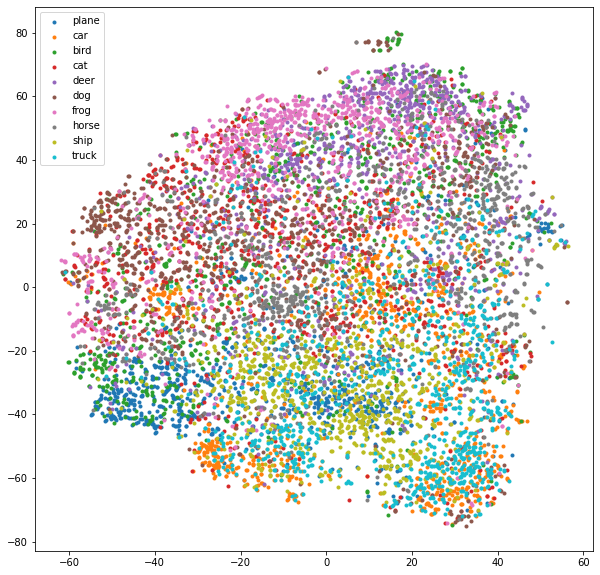

In [33]:
actual = []
deep_features = []

model.eval() # resnet18
with torch.no_grad():
    for data in testloader:
        images, labels = data[0].to(device), data[1].to(device)
        features = model(images) # 512 차원

        deep_features += features.cpu().numpy().tolist()
        actual += labels.cpu().numpy().tolist()

tsne = TSNE(n_components=2, random_state=0) # 사실 easy 함 sklearn 사용하니..
cluster = np.array(tsne.fit_transform(np.array(deep_features)))
actual = np.array(actual)

plt.figure(figsize=(10, 10))
cifar = ['plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
for i, label in zip(range(10), cifar):
    idx = np.where(actual == i)
    plt.scatter(cluster[idx, 0], cluster[idx, 1], marker='.', label=label)

plt.legend()
plt.show()

In [68]:
import torch
import numpy as np

import pandas as pd

from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE

dataset = torch.load('./dataset/spars15_supervised/processed/geometric_data_processed.pt')
edge5_X = []
edge5_y = []
for i in range(36,len(dataset)):
    data = dataset[i]
    x = np.array(data.x).flatten()
    x = list(x)
    edge5_X.append(x)
    y = np.array(data.y)
    y = list(y)
    edge5_y.append(y)
edge5_y = np.array(edge5_y).reshape(-1)
edge5_X = np.array(edge5_X)
print(edge5_y)
    
edge5_df = pd.DataFrame(edge5_X)
edge5_df['target'] = edge5_y
edge5_df.shape    
#logreg = LogisticRegression()
#rfe = RFE(logreg, n_features_to_select=10000, step=1)
#rfe = rfe.fit(edge5_X, edge5_y)    

[0 0 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 1 1 1 1 1 1 1]


(73, 26913)

In [69]:

#input data 
x=edge5_df.iloc[:,:-1] 
#output data
y=edge5_df.iloc[:,-1]

In [70]:
from sklearn.model_selection import train_test_split

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.20,
                                               random_state=100,
                                               stratify=y)

In [71]:
from sklearn import svm
from sklearn.model_selection import GridSearchCV
# Defining the parameters grid for GridSearchCV
param_grid={'C':[0.1,1,10,100],
            'gamma':[0.0001,0.001,0.1,1],
            'kernel':['rbf','poly']}
  
# Creating a support vector classifier
svc=svm.SVC(probability=True)
  
# Creating a model using GridSearchCV with the parameters grid
svm=GridSearchCV(svc,param_grid)

In [72]:

# Training the model using the training data
svm.fit(x_train,y_train)

GridSearchCV(estimator=SVC(probability=True),
             param_grid={'C': [0.1, 1, 10, 100],
                         'gamma': [0.0001, 0.001, 0.1, 1],
                         'kernel': ['rbf', 'poly']})

In [30]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score


# Testing the model using the testing data
y_pred = svm.predict(x_test)
print(y_pred)
train_pred = svm.predict(x_train)
  
# Calculating the accuracy of the model
accuracy = accuracy_score(y_pred, y_test)
auc = roc_auc_score(y_test, y_pred)
accuracy2 = accuracy_score(train_pred , y_train)
auc2 = roc_auc_score(y_train, train_pred)
  
# Print the accuracy of the model
print(f"The model is {accuracy*100}% accurate")
print(f"The model is {auc*100}% AUC")
print(accuracy2)
print(auc2)

[0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
The model is 72.72727272727273% accurate
The model is 57.14285714285714% AUC
1.0
1.0


In [66]:
# logistic regression
from sklearn.linear_model import LogisticRegression

log_regression = LogisticRegression()
log_regression.fit(x_train,y_train)


LogisticRegression()

In [67]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score


# Testing the model using the testing data
y_pred_proba = log_regression.predict(x_test)
print(y_pred_proba)
print(y_test)
train_pred = log_regression.predict(x_train)

# Calculating the accuracy of the model
accuracy = accuracy_score(y_pred_proba, y_test)
auc = roc_auc_score(y_test, y_pred_proba)
accuracy2 = accuracy_score(train_pred , y_train)
auc2 = roc_auc_score(y_train, train_pred)
  
# Print the accuracy of the model
print(f"The model is {accuracy*100}% accurate")
print(f"The model is {auc*100}% AUC")
print(accuracy2)
print(auc2)

[0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
62     1
57     0
56     0
91     0
78     1
24     0
14     0
8      0
48     1
52     0
36     0
15     0
45     0
61     1
66     1
83     0
34     0
10     0
100    0
63     1
47     1
92     0
Name: target, dtype: int64
The model is 77.27272727272727% accurate
The model is 64.28571428571428% AUC
1.0
1.0


In [16]:
sub_list = open('/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/node/sub_list','r').read().split('\n')
print(sub_list)

['28675', '28676', '28677', '28678', '28679', '28680', '28681', '28682', '28683', '28684', '28685', '28686', '28687', '28688', '28689', '28690', '28691', '28692', '28693', '28694', '28695', '28696', '28697', '28699', '28700', '28701', '28702', '28703', '28704', '28705', '28706', '28707', '28708', '28709', '28710', '28711', '28712', '28713', '28714', '28715', '28716', '28717', '28718', '28719', '28720', '28721', '28722', '28723', '28724', '28725', '28726', '28727', '28728', '28729', '28730', '28731', '28732', '28733', '28741', '28742', '28743', '28744', '28745', '28746', '28747', '28748', '28749', '28750', '28752', '28753', '28754', '28758', '28760', '28761', '28762', '28764', '28765', '28766', '28767', '28768', '28771', '28774', '28778', '28779', '28780', '28820', '28821', '28822', '28823', '28824', '28825', '28826', '28827', '28828', '28829', '28830', '28831', '28832', '28834', '28835', '28836', '28837', '28838', '28839', '28840', '28841', '28842', '28843', '28844', '28845', '28846', 

In [18]:
sub_list = open('/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/node/sub_list','r').read().split('\n')
sub_list.pop()
sub_list.pop()
one_hot = torch.zeros(116,116)
for i in range(116):
    one_hot[i][i] = 1

for i in sub_list:
    with open(f'/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/node/pcc_ROISignals_{i}.txt','r') as f:
        #l = pickle.load(f)
        x =[[float(num) for num in line.split(',')] for line in f]
        x = torch.FloatTensor(x)
        x = torch.transpose(x,0,1)
        x = torch.cat((x,one_hot),1)
        print(x.shape)

#data = torch.load('dataset/spars15_supervised/processed/geometric_data_processed.pt')
#print(data[1].x.shape)

torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size(

In [148]:
sub_list = open('/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/node/sub_list','r').read().split('\n')
sub_list.pop()
sub_list.pop()
print(len(sub_list))
f= open('/nasdata4/kyj0305/ABIDE/ABIDE2/abide2_diagnosis.csv', 'r').read().split()
dx = np.array(f)
dx = np.reshape(f, (1114,2))
for i in sub_list:
    for j in range(1114):
        if i == dx[j][0]:
            f = open(f'/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/y/{i}.txt', 'w')
            f.write(str(int(dx[j][1])-1))
            f.close()
            



994


In [26]:
import numpy as np
from scipy import stats, linalg
import pingouin as pg
import pandas as pd

def partial_corr(C):
    C = np.asarray(C)
    p = C.shape[1]
    P_corr = np.zeros((p, p), dtype=float)
    for i in range(p):
        P_corr[i, i] = 1
        for j in range(i+1, p):
            idx = np.ones(p, dtype=bool)
            idx[i] = False
            idx[j] = False
            beta_i = linalg.lstsq(C[:, idx], C[:, j])[0]
            beta_j = linalg.lstsq(C[:, idx], C[:, i])[0]

            res_j = C[:, j] - C[:, idx].dot( beta_i)
            res_i = C[:, i] - C[:, idx].dot(beta_j)
            
            corr = stats.pearsonr(res_i, res_j)[0]
            P_corr[i, j] = corr
            P_corr[j, i] = corr
        
    return P_corr

sub_list = open('/nasdata4/kyj0305/ABIDE/comorbid_preprop/ASD+ADHD/seleted_sub','r').read().split('\n')
sub_list.pop()
    
dataset = []

for i in sub_list:
    with open(f'/nasdata4/kyj0305/ABIDE/comorbid_preprop/ASD+ADHD/result/ROISignals_{i}.txt','r') as f:
        x =np.array([[float(num) for num in line.split()] for line in f])
        df = pd.DataFrame(x)
        pcc = df.pcorr()
        pcc = np.array(pcc)
        np.savetxt(f'/nasdata4/kyj0305/ABIDE/comorbid_preprop/ASD+ADHD/result/pcc_new_{i}.txt', pcc, fmt='%.18e', delimiter=' ', newline='\n')
        

In [6]:
import numpy as np
import matplotlib.pyplot as plt

sub_list = open('/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_cc/cc_list','r').read().split('\n')
#sub_list = sub_list[40:80]
print(sub_list)
sub_list.pop()
new_list=[]
for i in sub_list:
    i = i.rstrip('.txt')
    i = i.lstrip('cc_')
    new_list.append(i)
f = open("/nasdata4/kyj0305/ABIDE/ASD_preprop/ASD_only/select_list", 'w')
for i in new_list:
    f.write(f'{i}\n')
f.close()
    

['cc_28752.txt', 'cc_28754.txt', 'cc_28761.txt', 'cc_28764.txt', 'cc_28765.txt', 'cc_28768.txt', 'cc_28771.txt', 'cc_28778.txt', 'cc_28787.txt', 'cc_28788.txt', 'cc_28790.txt', 'cc_28791.txt', 'cc_28795.txt', 'cc_28796.txt', 'cc_28800.txt', 'cc_28802.txt', 'cc_28808.txt', 'cc_28810.txt', 'cc_28815.txt', 'cc_28820.txt', 'cc_28822.txt', 'cc_28824.txt', 'cc_28825.txt', 'cc_28835.txt', 'cc_28838.txt', 'cc_28843.txt', 'cc_28844.txt', 'cc_28853.txt', 'cc_28855.txt', 'cc_28857.txt', 'cc_28859.txt', 'cc_28861.txt', 'cc_28864.txt', 'cc_28865.txt', 'cc_28872.txt', 'cc_28890.txt', 'cc_28897.txt', 'cc_28898.txt', 'cc_28899.txt', 'cc_28906.txt', 'cc_28908.txt', 'cc_28927.txt', 'cc_28936.txt', 'cc_28940.txt', 'cc_28941.txt', 'cc_28963.txt', 'cc_28986.txt', 'cc_28987.txt', 'cc_28992.txt', 'cc_29030.txt', 'cc_29046.txt', 'cc_29063.txt', 'cc_29099.txt', 'cc_29103.txt', 'cc_29108.txt', 'cc_29109.txt', 'cc_29111.txt', 'cc_29112.txt', 'cc_29113.txt', 'cc_29116.txt', 'cc_29162.txt', 'cc_29181.txt', 'cc_291

28752
y is "0" and type is <class 'str'>
ASD only


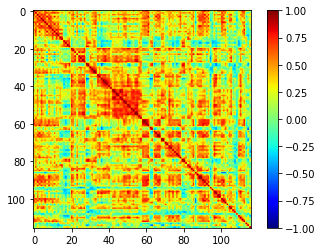

28754
y is "0" and type is <class 'str'>
ASD only


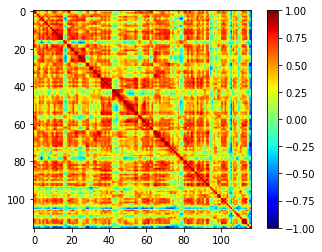

28761
y is "0" and type is <class 'str'>
ASD only


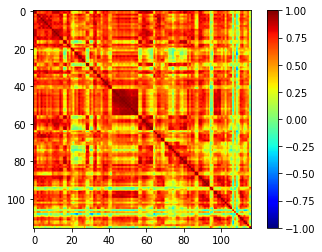

28764
y is "0" and type is <class 'str'>
ASD only


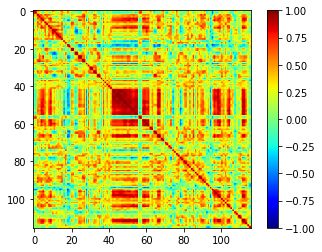

28765
y is "0" and type is <class 'str'>
ASD only


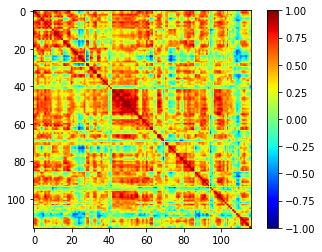

28768
y is "0" and type is <class 'str'>
ASD only


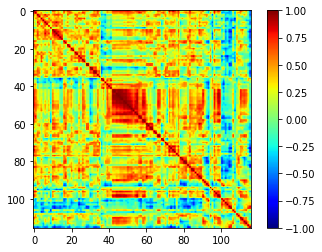

28771
y is "0" and type is <class 'str'>
ASD only


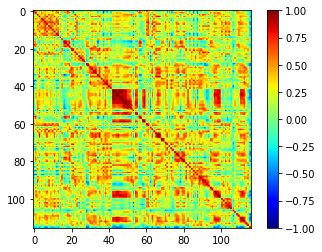

28778
y is "0" and type is <class 'str'>
ASD only


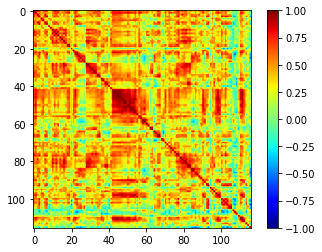

28787
y is "0" and type is <class 'str'>
ASD only


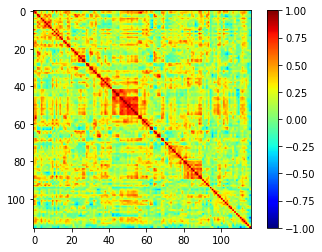

28788
y is "0" and type is <class 'str'>
ASD only


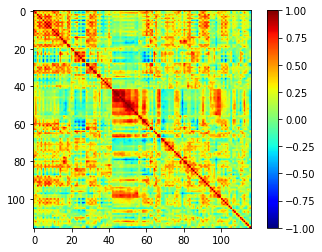

28790
y is "0" and type is <class 'str'>
ASD only


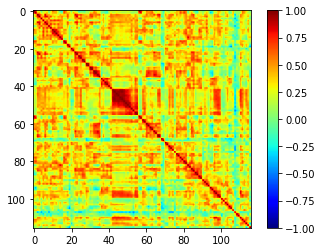

28791
y is "0" and type is <class 'str'>
ASD only


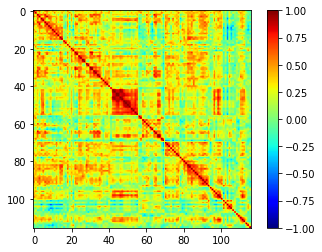

28795
y is "0" and type is <class 'str'>
ASD only


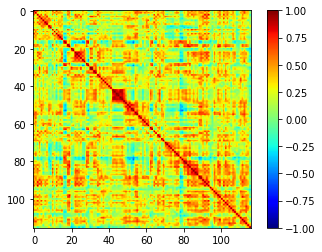

28796
y is "0" and type is <class 'str'>
ASD only


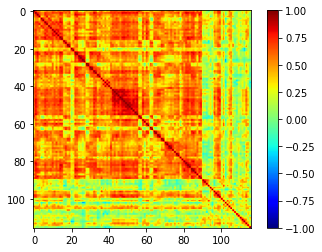

28800
y is "0" and type is <class 'str'>
ASD only


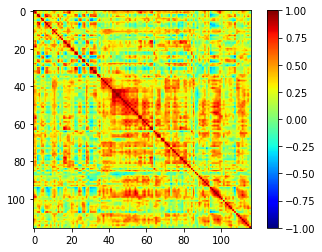

28802
y is "0" and type is <class 'str'>
ASD only


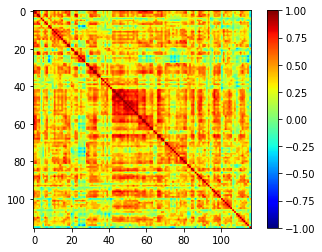

28808
y is "0" and type is <class 'str'>
ASD only


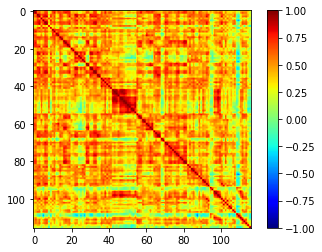

28810
y is "0" and type is <class 'str'>
ASD only


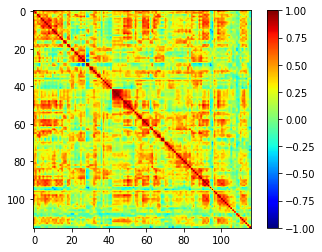

28815
y is "0" and type is <class 'str'>
ASD only


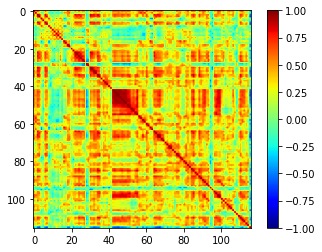

28820
y is "0" and type is <class 'str'>
ASD only


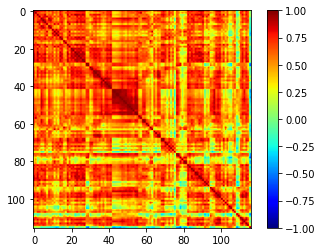

28822
y is "0" and type is <class 'str'>
ASD only


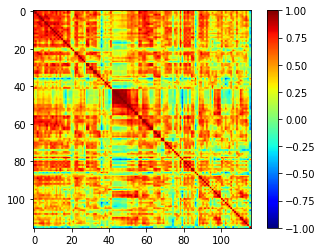

28824
y is "0" and type is <class 'str'>
ASD only


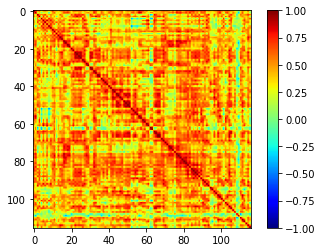

28825
y is "0" and type is <class 'str'>
ASD only


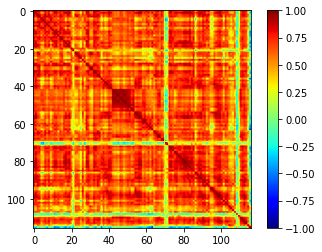

28835
y is "0" and type is <class 'str'>
ASD only


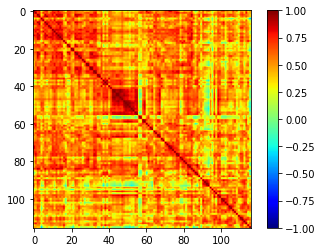

28838
y is "0" and type is <class 'str'>
ASD only


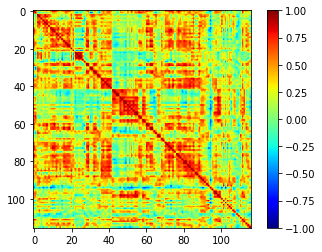

28843
y is "0" and type is <class 'str'>
ASD only


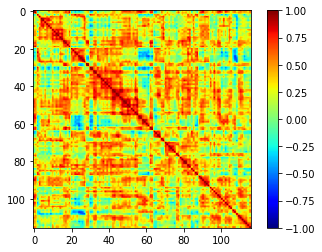

28844
y is "0" and type is <class 'str'>
ASD only


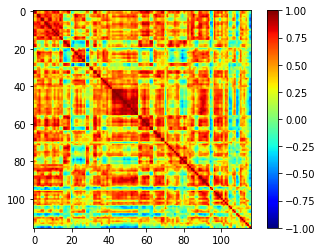

28853
y is "0" and type is <class 'str'>
ASD only


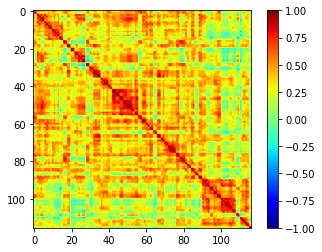

28855
y is "0" and type is <class 'str'>
ASD only


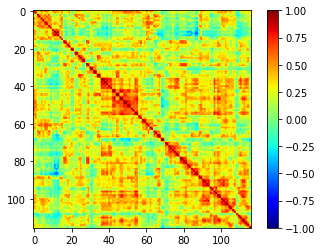

28857
y is "0" and type is <class 'str'>
ASD only


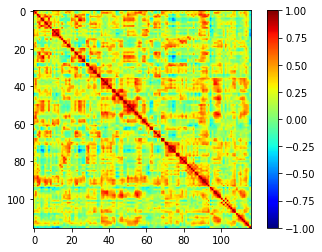

28859
y is "0" and type is <class 'str'>
ASD only


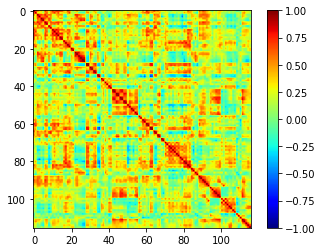

28861
y is "0" and type is <class 'str'>
ASD only


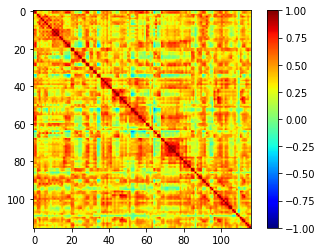

28864
y is "0" and type is <class 'str'>
ASD only


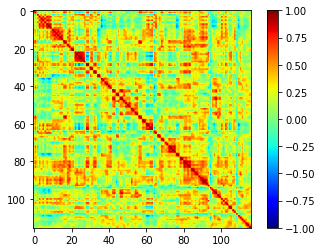

28865
y is "0" and type is <class 'str'>
ASD only


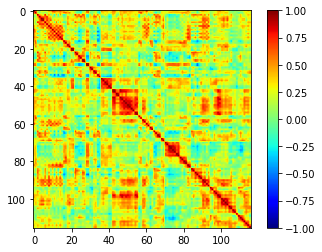

28872
y is "0" and type is <class 'str'>
ASD only


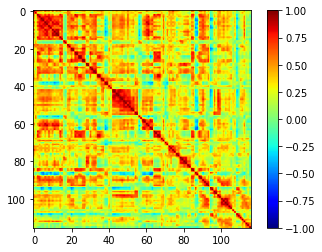

28890
y is "0" and type is <class 'str'>
ASD only


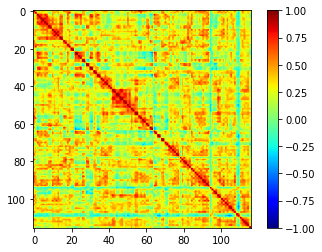

28897
y is "0" and type is <class 'str'>
ASD only


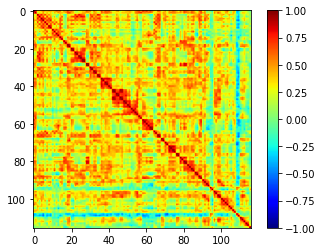

28898
y is "0" and type is <class 'str'>
ASD only


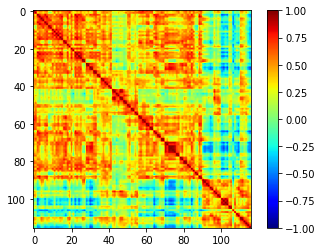

28899
y is "0" and type is <class 'str'>
ASD only


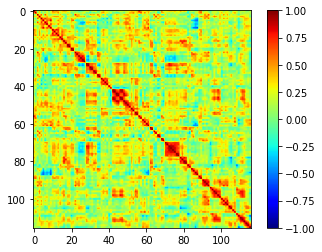

28906
y is "0" and type is <class 'str'>
ASD only


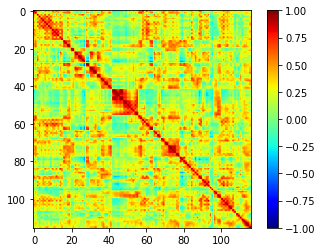

28908
y is "0" and type is <class 'str'>
ASD only


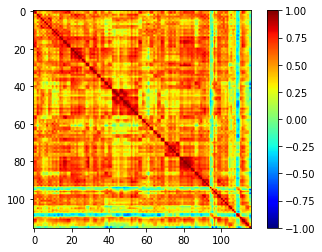

28927
y is "1" and type is <class 'str'>
ASD + ADHD


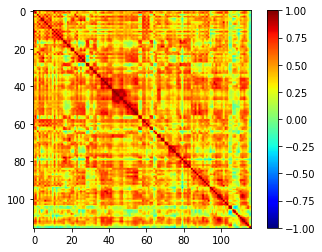

28936
y is "0" and type is <class 'str'>
ASD only


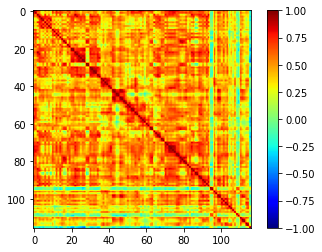

28940
y is "0" and type is <class 'str'>
ASD only


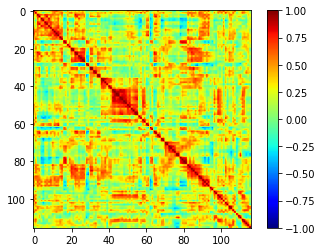

28941
y is "1" and type is <class 'str'>
ASD + ADHD


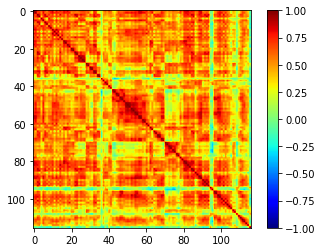

28963
y is "0" and type is <class 'str'>
ASD only


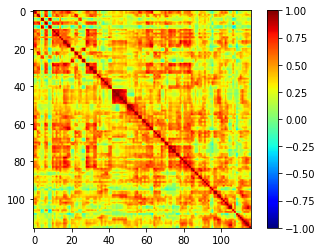

28986
y is "0" and type is <class 'str'>
ASD only


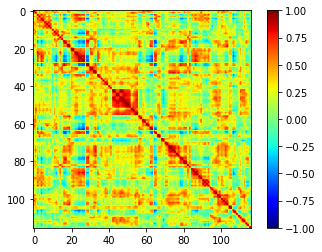

28987
y is "1" and type is <class 'str'>
ASD + ADHD


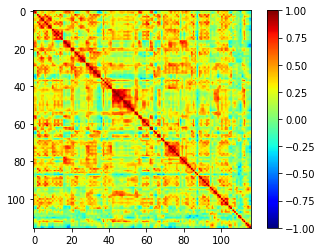

28992
y is "1" and type is <class 'str'>
ASD + ADHD


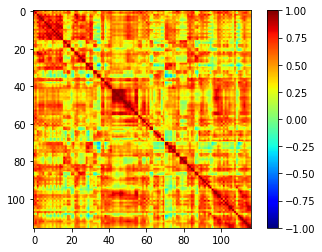

29030
y is "0" and type is <class 'str'>
ASD only


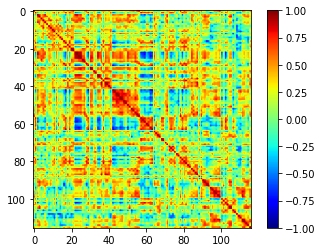

29046
y is "0" and type is <class 'str'>
ASD only


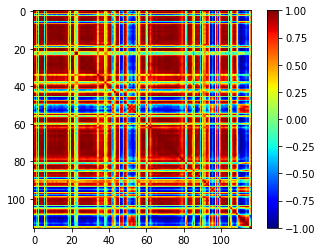

29063
y is "0" and type is <class 'str'>
ASD only


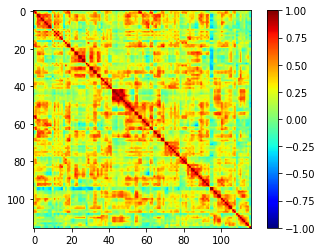

29099
y is "0" and type is <class 'str'>
ASD only


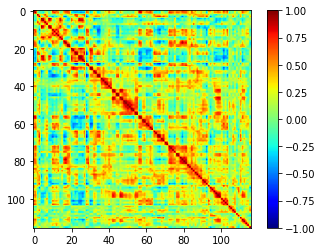

29103
y is "0" and type is <class 'str'>
ASD only


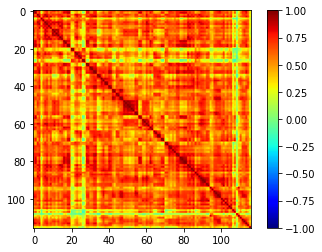

29108
y is "0" and type is <class 'str'>
ASD only


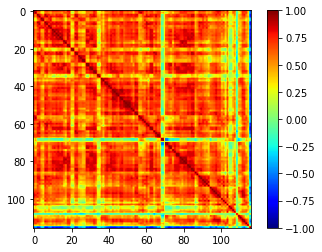

29109
y is "0" and type is <class 'str'>
ASD only


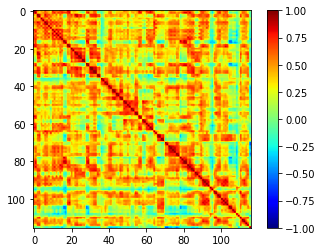

29111
y is "0" and type is <class 'str'>
ASD only


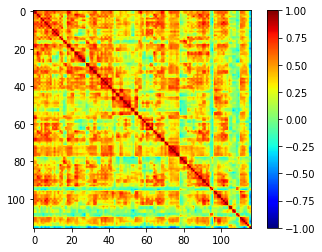

29112
y is "0" and type is <class 'str'>
ASD only


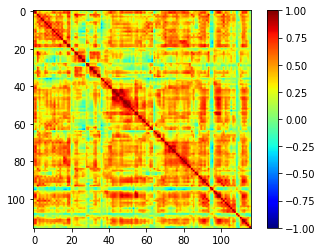

29113
y is "0" and type is <class 'str'>
ASD only


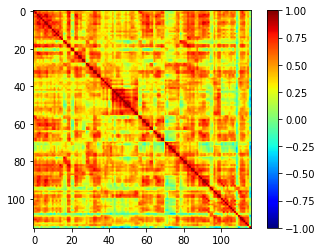

29116
y is "0" and type is <class 'str'>
ASD only


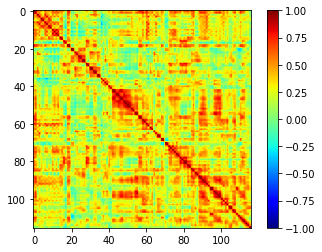

29162
y is "1" and type is <class 'str'>
ASD + ADHD


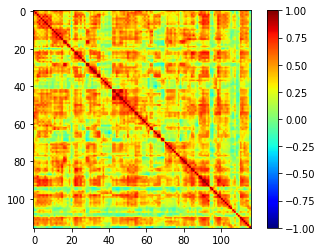

29181
y is "1" and type is <class 'str'>
ASD + ADHD


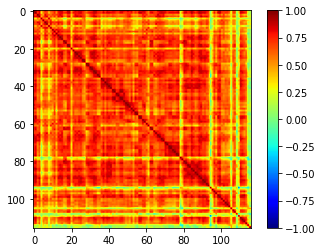

29184
y is "1" and type is <class 'str'>
ASD + ADHD


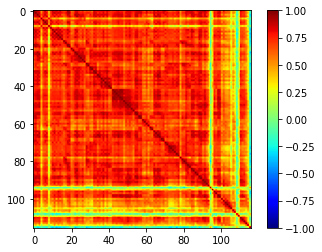

29192
y is "1" and type is <class 'str'>
ASD + ADHD


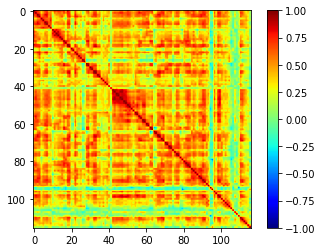

29197
y is "1" and type is <class 'str'>
ASD + ADHD


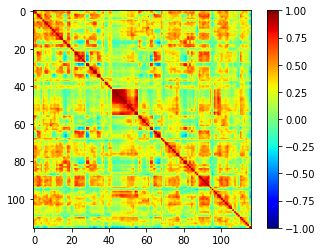

29198
y is "1" and type is <class 'str'>
ASD + ADHD


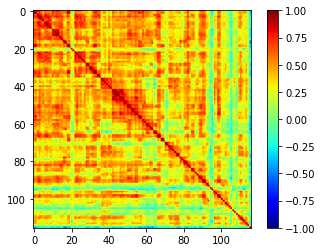

29201
y is "1" and type is <class 'str'>
ASD + ADHD


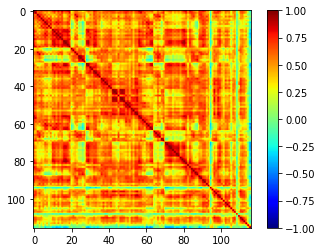

29218
y is "1" and type is <class 'str'>
ASD + ADHD


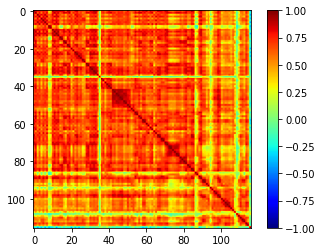

29273
y is "1" and type is <class 'str'>
ASD + ADHD


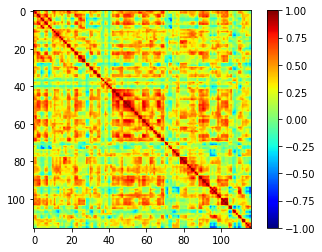

29277
y is "1" and type is <class 'str'>
ASD + ADHD


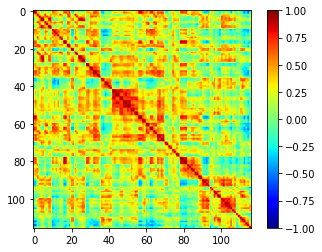

29281
y is "1" and type is <class 'str'>
ASD + ADHD


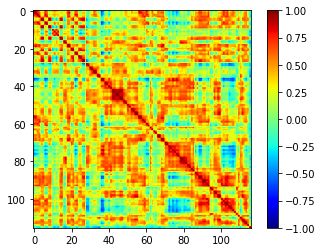

29290
y is "1" and type is <class 'str'>
ASD + ADHD


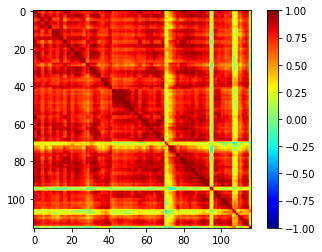

29291
y is "1" and type is <class 'str'>
ASD + ADHD


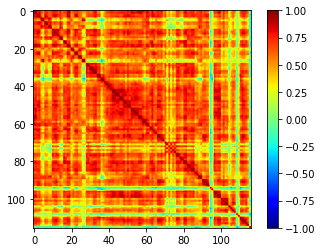

29385
y is "1" and type is <class 'str'>
ASD + ADHD


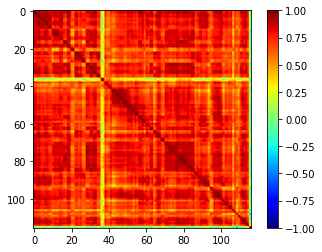

29393
y is "1" and type is <class 'str'>
ASD + ADHD


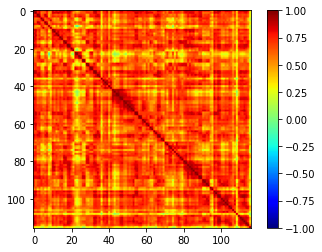

29404
y is "1" and type is <class 'str'>
ASD + ADHD


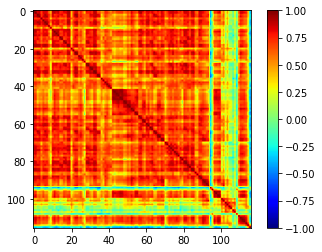

29435
y is "1" and type is <class 'str'>
ASD + ADHD


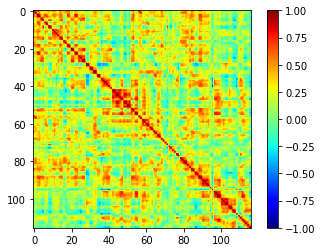

29479
y is "1" and type is <class 'str'>
ASD + ADHD


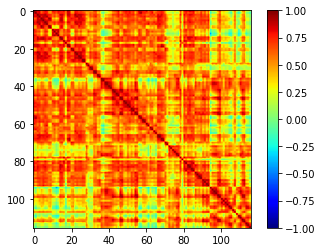

29482
y is "1" and type is <class 'str'>
ASD + ADHD


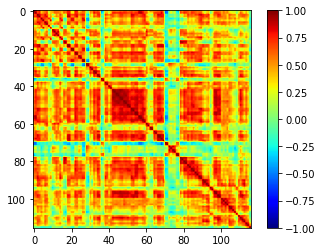

29502
y is "0" and type is <class 'str'>
ASD only


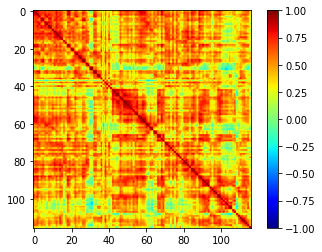

29507
y is "0" and type is <class 'str'>
ASD only


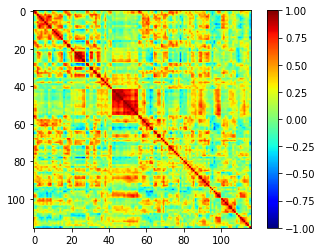

29509
y is "0" and type is <class 'str'>
ASD only


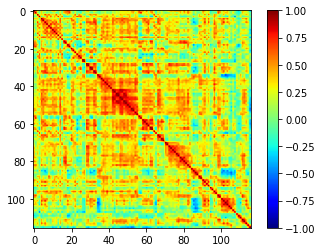

29568
y is "0" and type is <class 'str'>
ASD only


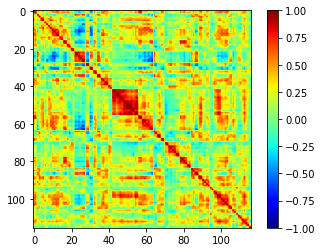

29572
y is "0" and type is <class 'str'>
ASD only


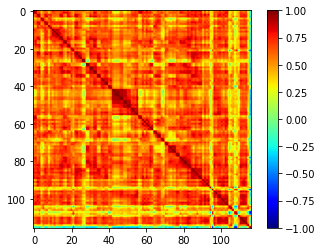

29612
y is "1" and type is <class 'str'>
ASD + ADHD


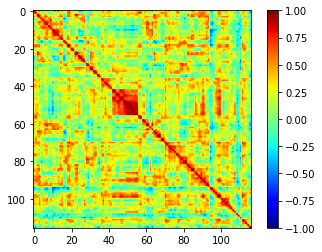

29615
y is "1" and type is <class 'str'>
ASD + ADHD


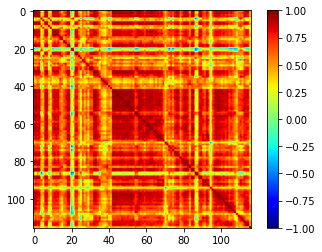

29729
y is "0" and type is <class 'str'>
ASD only


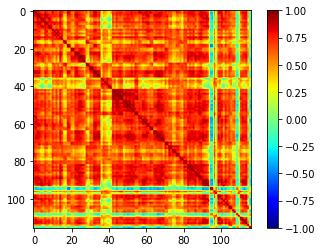

29730
y is "0" and type is <class 'str'>
ASD only


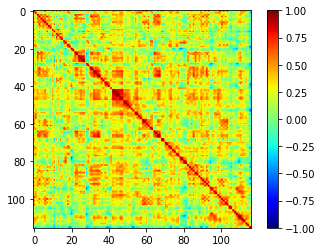

29733
y is "0" and type is <class 'str'>
ASD only


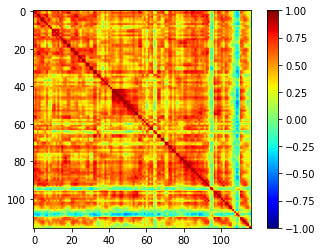

29734
y is "0" and type is <class 'str'>
ASD only


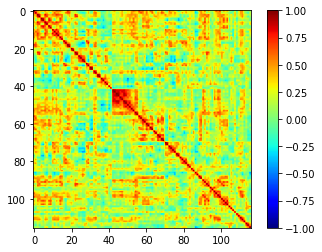

29735
y is "0" and type is <class 'str'>
ASD only


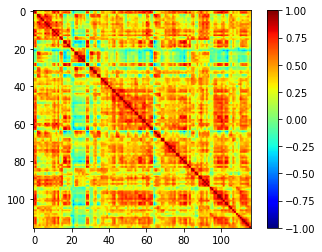

29736
y is "0" and type is <class 'str'>
ASD only


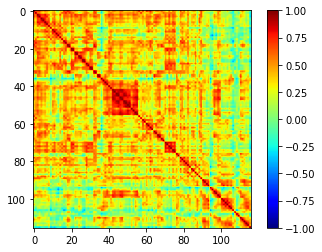

29737
y is "0" and type is <class 'str'>
ASD only


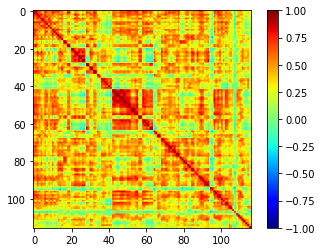

29738
y is "0" and type is <class 'str'>
ASD only


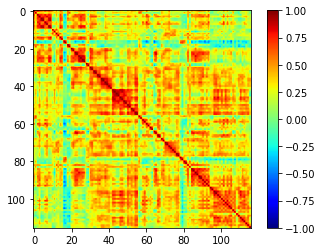

29740
y is "0" and type is <class 'str'>
ASD only


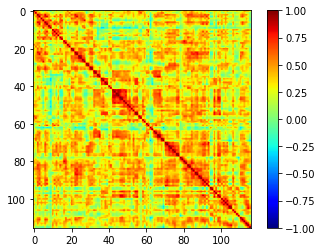

29864
y is "1" and type is <class 'str'>
ASD + ADHD


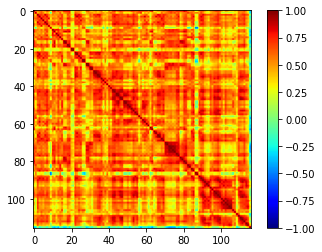

30005
y is "1" and type is <class 'str'>
ASD + ADHD


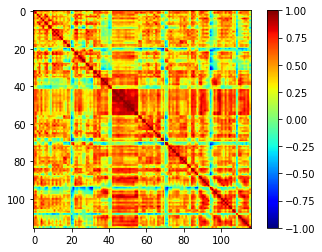

30229
y is "0" and type is <class 'str'>
ASD only


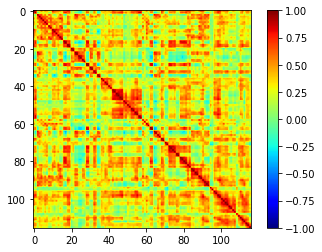

30233
y is "0" and type is <class 'str'>
ASD only


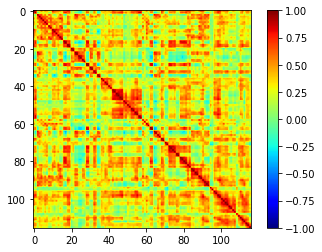

30237
y is "0" and type is <class 'str'>
ASD only


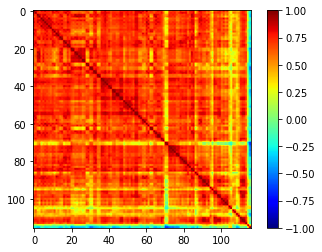

30239
y is "0" and type is <class 'str'>
ASD only


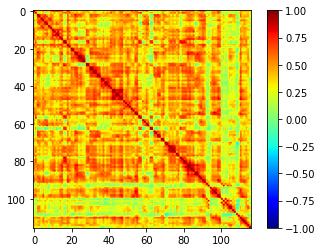

30247
y is "0" and type is <class 'str'>
ASD only


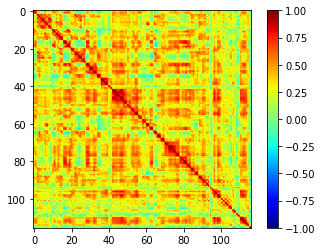

50804
y is "1" and type is <class 'str'>
ASD + ADHD


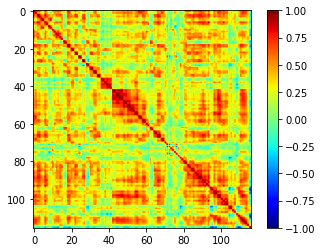

50968
y is "1" and type is <class 'str'>
ASD + ADHD


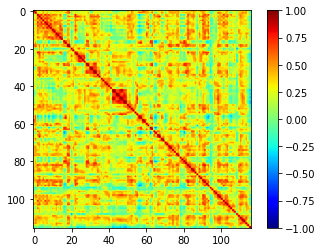

50977
y is "1" and type is <class 'str'>
ASD + ADHD


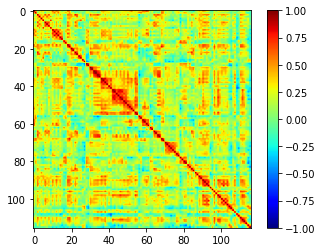

50986
y is "1" and type is <class 'str'>
ASD + ADHD


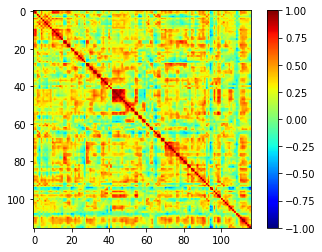

50988
y is "1" and type is <class 'str'>
ASD + ADHD


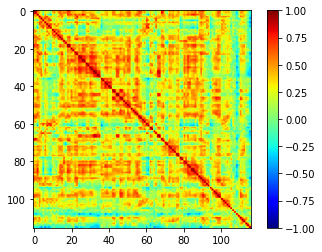

51000
y is "1" and type is <class 'str'>
ASD + ADHD


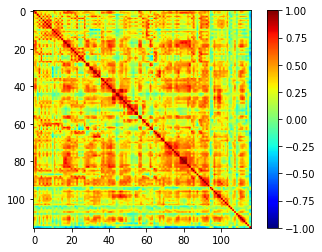

51010
y is "1" and type is <class 'str'>
ASD + ADHD


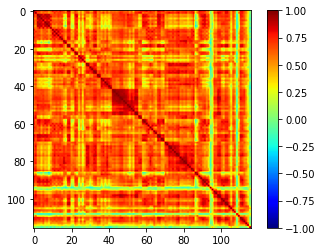

In [4]:
import numpy as np
import matplotlib.pyplot as plt

sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/passedQC/list','r').read().split('\n')
for i in new_list:
    print(i)
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/y/{i}.txt','r') as f:
        y = str(f.readlines())[2]
    print(f'y is "{y}" and type is {type(y)}')
    if y == '0':
        print('ASD only')
    else:
        print('ASD + ADHD')
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_cc/cc_{i}.txt','r') as f:
        x =np.array([[float(num) for num in line.split(',')] for line in f])
        plt.imshow(x, vmin=-1, vmax=1,cmap='jet')
        plt.colorbar()
        plt.show()
        

KKI_0050774


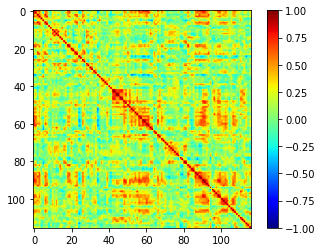

KKI_0050775


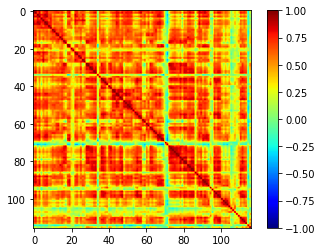

KKI_0050776


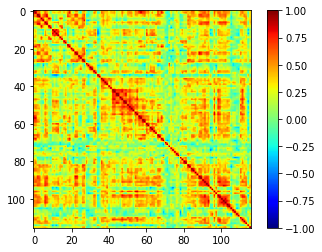

KKI_0050777


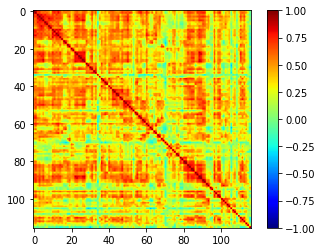

KKI_0050778


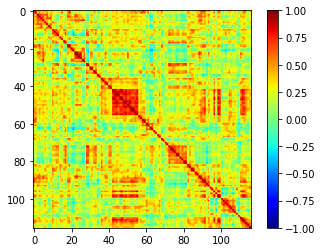

KKI_0050779


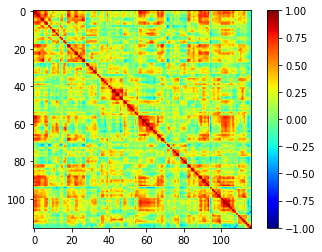

KKI_0050780


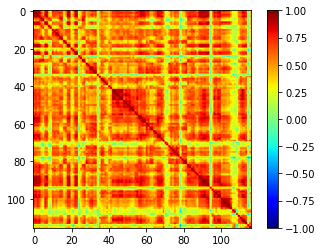

KKI_0050781


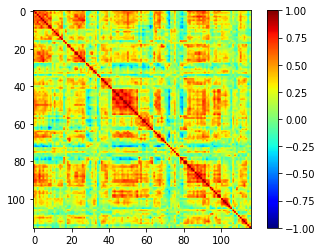

KKI_0050782


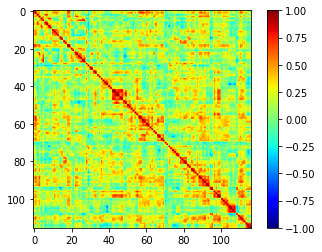

KKI_0050783


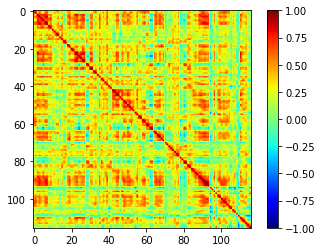

In [29]:
import numpy as np
import matplotlib.pyplot as plt

sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/passedQC/list','r').read().split('\n')
sub_list = sub_list[30:40]
for i in sub_list:
    print(i)
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/passedQC/ROICorrelation_FisherZ_{i}.txt','r') as f:
        x =np.array([[float(num) for num in line.split(' ')] for line in f])
        plt.imshow(x, vmin=-1, vmax=1,cmap='jet')
        plt.colorbar()
        plt.show()

In [25]:
#ASD and control classification(downstream task)을 위한 dataset 만들기
sub_list = open('/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/node/sub_list','r').read().split('\n')
sub_list.pop()
sub_list.pop()
one_hot = torch.zeros(116,116)
for i in range(116):
    one_hot[i][i] = 1
    
dataset = []
for i in sub_list:
    with open(f'/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/node/pcc_new_{i}.txt','r') as f:
        #l = pickle.load(f)
        x =[[float(num) for num in line.split()] for line in f]
        x = torch.FloatTensor(x)
        x = torch.transpose(x,0,1)
        x = torch.cat((x,one_hot),1)
        
    with open(f'/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/y/{i}.txt','r') as f:
        f = f.read()
        y = torch.LongTensor([int(f)])
        
    with open(f'/nasdata4/kyj0305/ABIDE/ABIDE2/preprocessed/result/edge/edge_index15/{i}_edge_index.txt') as f:
        edge_index = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_index = torch.transpose(edge_index,0,1)

    my_data = Data(x=x, edge_index=edge_index, y=y)

    dataset.append(my_data)
print(x)
print(len(dataset))

torch.save(dataset,'dataset/spars15_supervised/asd_cn/processed/geometric_data_processed.pt')

tensor([[ 1.0000, -0.8849,  0.7444,  ...,  0.0000,  0.0000,  0.0000],
        [-0.8849,  1.0000,  0.9695,  ...,  0.0000,  0.0000,  0.0000],
        [ 0.7444,  0.9695,  1.0000,  ...,  0.0000,  0.0000,  0.0000],
        ...,
        [-0.7968, -0.4295,  0.2002,  ...,  1.0000,  0.0000,  0.0000],
        [-0.9427, -0.9845,  0.9169,  ...,  0.0000,  1.0000,  0.0000],
        [ 0.6628,  0.3085, -0.1011,  ...,  0.0000,  0.0000,  1.0000]])
939


In [4]:
import argparse 

from loader import BioDataset
from torch.utils.data.dataloader import DataLoader
from dataloader import DataLoaderFinetune
from splitters import random_split, species_split
from sklearn.model_selection import StratifiedKFold
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from tqdm import tqdm
import numpy as np

from model import GNN, GNN_graphpred
from sklearn.metrics import roc_auc_score, roc_curve

import pandas as pd

import os
import pickle
#from pretrain_greverative_joao import graphcl
from pretrain_joao import graphcl
from torchsummary import summary as summary
model = GNN_graphpred(3,300,2)
model_graphcl = graphcl(model.gnn)
model.gnn = model_graphcl.gnn
summary(model, input_size=(116,232))

AttributeError: 'Tensor' object has no attribute 'x'

: 

### ABIDE에서 전처리 해준 ABIDE 1 (ASD vs Control) dataset 만들기

In [1]:
sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/list','r').read().split('\n')
print(sub_list)

['Pitt_0050003', 'Pitt_0050004', 'Pitt_0050005', 'Pitt_0050006', 'Pitt_0050007', 'Pitt_0050008', 'Pitt_0050009', 'Pitt_0050010', 'Pitt_0050011', 'Pitt_0050012', 'Pitt_0050013', 'Pitt_0050014', 'Pitt_0050015', 'Pitt_0050016', 'Pitt_0050017', 'Pitt_0050019', 'Pitt_0050020', 'Pitt_0050022', 'Pitt_0050023', 'Pitt_0050024', 'Pitt_0050025', 'Pitt_0050026', 'Pitt_0050027', 'Pitt_0050028', 'Pitt_0050029', 'Pitt_0050030', 'Pitt_0050031', 'Pitt_0050032', 'Pitt_0050033', 'Pitt_0050034', 'Pitt_0050035', 'Pitt_0050036', 'Pitt_0050037', 'Pitt_0050038', 'Pitt_0050039', 'Pitt_0050040', 'Pitt_0050041', 'Pitt_0050042', 'Pitt_0050043', 'Pitt_0050044', 'Pitt_0050045', 'Pitt_0050046', 'Pitt_0050047', 'Pitt_0050048', 'Pitt_0050049', 'Pitt_0050050', 'Pitt_0050051', 'Pitt_0050052', 'Pitt_0050053', 'Pitt_0050054', 'Pitt_0050055', 'Pitt_0050056', 'Pitt_0050057', 'Pitt_0050058', 'Pitt_0050059', 'Pitt_0050060', 'Olin_0050102', 'Olin_0050103', 'Olin_0050104', 'Olin_0050105', 'Olin_0050106', 'Olin_0050107', 'Olin_0

In [25]:
import numpy as np
from scipy import stats, linalg
import pingouin as pg
import pandas as pd

sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/list','r').read().split('\n')
sub_list.pop()
#print(sub_list)
dataset = []
x = pd.read_csv('/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/Pitt_0050008_roi_aal.csv')
df = pd.DataFrame(x)
pcc = df.pcorr()
print(pcc.shape)
for i in sub_list:
    print('start', i)
    x = pd.read_csv(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/{i}_roi_aal.csv')
    df = pd.DataFrame(x)
    #pcc = df.pcorr()
    cc = df.corr(method='pearson')
    #pcc = np.array(pcc)
    #np.savetxt(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/pcc_{i}.txt', pcc, fmt='%.18e', delimiter=' ', newline='\n')
    np.savetxt(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/edge/ROICorrelation_FisherZ_{i}.txt', cc, fmt='%.18e', delimiter=' ', newline='\n') #fisher z 를 하지는 않았지만 처리하기 편하게
#print(pcc)                

(116, 116)
start Pitt_0050003
start Pitt_0050004
start Pitt_0050005
start Pitt_0050006
start Pitt_0050007
start Pitt_0050008
start Pitt_0050009
start Pitt_0050010
start Pitt_0050011
start Pitt_0050012
start Pitt_0050013
start Pitt_0050014
start Pitt_0050015
start Pitt_0050016
start Pitt_0050017
start Pitt_0050019
start Pitt_0050020
start Pitt_0050022
start Pitt_0050023
start Pitt_0050024
start Pitt_0050025
start Pitt_0050026
start Pitt_0050027
start Pitt_0050028
start Pitt_0050029
start Pitt_0050030
start Pitt_0050031
start Pitt_0050032
start Pitt_0050033
start Pitt_0050034
start Pitt_0050035
start Pitt_0050036
start Pitt_0050037
start Pitt_0050038
start Pitt_0050039
start Pitt_0050040
start Pitt_0050041
start Pitt_0050042
start Pitt_0050043
start Pitt_0050044
start Pitt_0050045
start Pitt_0050046
start Pitt_0050047
start Pitt_0050048
start Pitt_0050049
start Pitt_0050050
start Pitt_0050051
start Pitt_0050052
start Pitt_0050053
start Pitt_0050054
start Pitt_0050055
start Pitt_0050056
s

In [33]:
sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/list','r').read().split('\n')
sub_list.pop()
one_hot = torch.zeros(116,116)
for i in range(116):
    one_hot[i][i] = 1

for i in sub_list:
   with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/pcc_{i}.txt','r') as f:
       #l = pickle.load(f)
       x =[[float(num) for num in line.split(' ')] for line in f]
       x = torch.FloatTensor(x)
       x = torch.transpose(x,0,1)
       x = torch.cat((x,one_hot),1)
       print(x.shape)

#data = torch.load('dataset/spars15_supervised/processed/geometric_data_processed.pt')
#print(data[1].x.shape)

torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size([116, 232])
torch.Size(

In [39]:
sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/list','r').read().split('\n')
sub_list.pop()
print(len(sub_list))
f = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/diagnosis', 'r').read().split()
dx = np.array(f)
print(dx)
for i,j in enumerate(sub_list):
        f = open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/y/{j}.txt', 'w')
        f.write(str(int(dx[i])-1))
        f.close()
            



989
['1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1'
 '1' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2'
 '2' '2' '1' '1' '1' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2'
 '2' '2' '2' '2' '2' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1'
 '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '2'
 '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '1' '1' '1' '1' '1'
 '1' '1' '1' '1' '1' '1' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2'
 '2' '2' '1' '2' '2' '2' '2' '1' '2' '2' '2' '1' '2' '1' '1' '1' '1' '1'
 '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '2'
 '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '1' '1' '1' '1' '1'
 '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1'
 '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '1'
 '1' '1' '1' '1' '1' '1' '1' '1' '1' '1' '2' '2' '2' '2' '2' '2' '2' '2'
 '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2' '2

In [32]:
#ABIDE1에서 제공하는 전처리된 aal roi 사용해서 ASD and control classification(downstream task)을 위한 dataset 만들기
sub_list = open('/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/balance_sub_list','r').read().split('\n')
sub_list.pop()
# one_hot = torch.zeros(116,116)
# for i in range(116):
#     one_hot[i][i] = 1
dataset=[]
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_cc/cc_{i}.txt','r') as f:
       #l = pickle.load(f)
       x =[[float(num) for num in line.split(',')] for line in f]
       x = np.array(x)
       np.fill_diagonal(x,0)
       x = np.arctanh(x)
       x = torch.FloatTensor(x)
       x = torch.transpose(x,0,1)
       #x = torch.cat((x,one_hot),1)
       print(x.shape)
        
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/y/{i}.txt','r') as f:
        f = f.read()
        y = torch.LongTensor([int(f)])
        
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/edge_index20/{i}_edge_index.txt') as f:
        edge_index = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_index = torch.transpose(edge_index,0,1)

    my_data = Data(x=x, edge_index=edge_index, y=y)

    dataset.append(my_data)
print(x)
print(len(dataset))

torch.save(dataset,'dataset/spars20_supervised/only_cc_balanced/processed/geometric_data_processed.pt')

torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size([116, 116])
torch.Size(

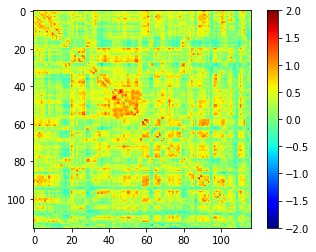

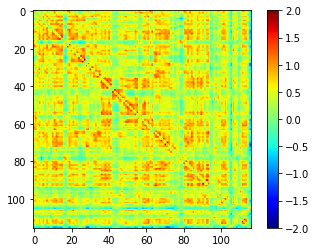

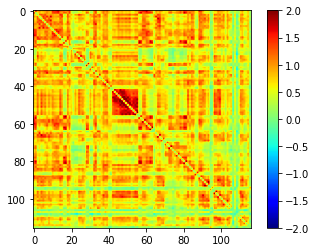

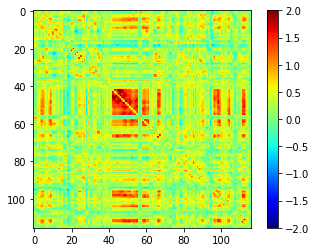

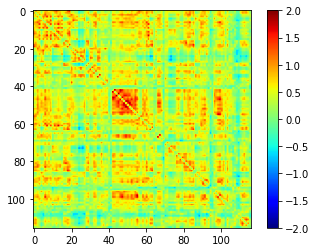

...

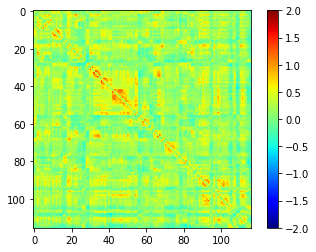

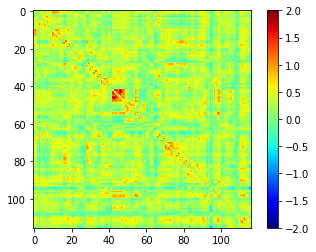

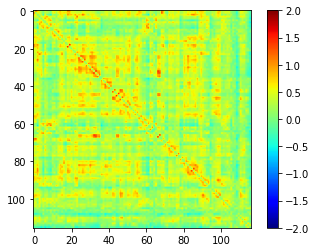

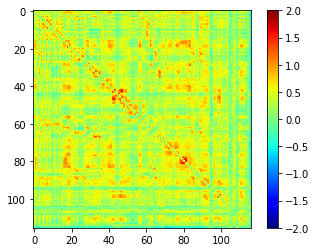

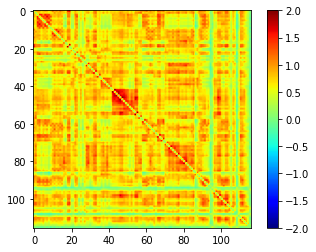

In [10]:
for i in sub_list:
    with open(f'/nasdata3/kyj/graphcl/GraphCL_Automated/ASD_data/x_cc/cc_{i}.txt','r') as f:
       #l = pickle.load(f)
       x =[[float(num) for num in line.split(',')] for line in f]
       x = np.array(x)
       np.fill_diagonal(x,0)
       x = np.arctanh(x)
       x = torch.FloatTensor(x)
       x = torch.transpose(x,0,1)
       plt.imshow(x, vmin=-2, vmax=2, cmap='jet')
       plt.colorbar()
       plt.show()
        

In [58]:
import scipy.io as sio

roi_center_of_mass = sio.loadmat('/nasdata4/kyj0305/HCP/fMRI_prep/Results/ROISignals_funimgRWSCFB/ROI_CenterOfMass_922854')
roi_center_of_mass = roi_center_of_mass['ROICenter']
roi_center_of_mass = roi_center_of_mass[:,0:3]
roi_center_of_mass = torch.LongTensor(roi_center_of_mass)
print(roi_center_of_mass.shape)

torch.Size([116, 3])


In [3]:
#ABIDE1에서 제공하는 전처리된 aal roi 사용해서 ASD and control classification(downstream task)을 위한 dataset 만들기
import scipy.io as sio

sub_list = open('/nasdata4/kyj0305/ABIDE/Download_preprocess/list','r').read().split('\n')
sub_list.pop()

roi_center_of_mass = sio.loadmat('/nasdata4/kyj0305/HCP/fMRI_prep/Results/ROISignals_funimgRWSCFB/ROI_CenterOfMass_922854')
roi_center_of_mass = roi_center_of_mass['ROICenter']
roi_center_of_mass = roi_center_of_mass[:,0:3]
roi_center_of_mass = torch.LongTensor(roi_center_of_mass)
print(roi_center_of_mass.shape)
dataset=[]
for i in sub_list:
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/roi_aal_1d/pcc_{i}.txt','r') as f:
       #l = pickle.load(f)
       x =[[float(num) for num in line.split(' ')] for line in f]
       x = torch.FloatTensor(x)
       x = torch.transpose(x,0,1)
       x = torch.cat((x,roi_center_of_mass),1)
       #print(x)
        
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/y/{i}.txt','r') as f:
        f = f.read()
        y = torch.LongTensor([int(f)])
        
    with open(f'/nasdata4/kyj0305/ABIDE/Download_preprocess/edge/edge_index5/ROICorrelation_FisherZ_{i}_edge_index.txt') as f:
        edge_index = torch.LongTensor([[int(num) for num in line.split()] for line in f])
        edge_index = torch.transpose(edge_index,0,1)

    my_data = Data(x=x, edge_index=edge_index, y=y)

    dataset.append(my_data)
print(x)
print(len(dataset))

torch.save(dataset,'dataset/spars5_supervised/abide_asd_cn/only_cc/geometric_data_processed.pt')

torch.Size([116, 3])
tensor([[ 1.0000e+00, -3.9445e-02,  5.1317e-01,  ..., -3.9000e+01,
         -6.0000e+00,  5.1000e+01],
        [-3.9445e-02,  1.0000e+00,  2.2144e-02,  ...,  3.9000e+01,
         -9.0000e+00,  5.1000e+01],
        [ 5.1317e-01,  2.2144e-02,  1.0000e+00,  ..., -1.8000e+01,
          3.6000e+01,  4.2000e+01],
        ...,
        [-2.8857e-01,  2.5962e-01,  2.2281e-01,  ...,  0.0000e+00,
         -6.3000e+01, -3.3000e+01],
        [ 8.8525e-02, -2.3562e-01, -5.8312e-02,  ...,  0.0000e+00,
         -5.4000e+01, -3.6000e+01],
        [ 2.2052e-01,  6.5399e-02,  7.3773e-02,  ...,  0.0000e+00,
         -4.5000e+01, -3.0000e+01]])
988


FileNotFoundError: [Errno 2] No such file or directory: 'dataset/spars20_supervised/abide_asd_cn_coordinate/processed/geometric_data_processed.pt'